In [1]:
import os
import numpy as np
import pandas as pd
import scipy.io
import mne
from mne_bids import BIDSPath, write_raw_bids, make_dataset_description

import logging
import re

import matplotlib
#matplotlib.use('Qt5Agg')

In [4]:
# =============================================================================
# Configuration and Constants
# =============================================================================

# Set up logging: messages will include timestamp, log level, and message content
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# === Path configuration ===
DS_ROOT_EEG = '/volumes/hyijie_psy/CPP/test_low_Ko'
DS_ROOT_BEH = '/volumes/hyijie_psy/CPP/low_Kosciessa_2021/behaviorData'

PATH_RAW_DATA_BIDS = '../data/data_raw_BIDS'
PATH_PREPROCESS_DATA_BIDS = '../data/preprocessData'

os.makedirs(PATH_RAW_DATA_BIDS, exist_ok=True)
os.makedirs(PATH_PREPROCESS_DATA_BIDS, exist_ok=True)

# === Constant definitions (for improved readability) ===
STIM_MARKER = 'Stimulus/S 17'  
RESP_MARKER = 'Stimulus/S130'  

SAMPLING_RATE = 256 

BIDS_TASK_LABEL_BEH = '_task-MAT'
BIDS_TASK_LABEL_EEG = '_task-dynamic'

BIDS_EEG_SUFFIX = '_eeg'
BIDS_BEH_SUFFIX = '_behavEEG'

# === Subject lists ===
SUBJECT_IDS = [f'sub-STSWD{i}' for i in [
    1261,1265,1266,1268,1270,1276,1281,1257,1247,1250,1252]]

#SUBJECT_IDS = [f'sub-STSWD{i}' for i in [
#    1117,1118,
#    ## 1120,
#    1126,1131,1132,1135,1136,1151,1160,1164,1167,1169,1172,1173,1178,1182,1215,1216,1219,1223,1227,1228,1233,1234,1237,1239,1240,1243,
#    #1245,
#    1247,1250,1252,1257,1261,1265,1266,1268,
#    #1270,
#    1276,
#    #1281
#    ]]


SUBJECT_IDS = [f'sub-STSWD{i}' for i in [
    1117,1118,1120,1126,1131,1132,1135,1136,
    1151,1160,1164,1167,1169,1172,1173,1178,
    1182,1215,1216,1219,1223,1227,1228,1233,
    1234,1237,1240,1243,1245,1247,1250,
    1252,1257,1261,1265,1266,1268,1270,1276,1281]] #1239,


# 1126: no REST, no T2w
# 1172: bad T1w quality due to partial coil disconnect
# 1125, 1213 and 1214 were dropped as pilot subjects (no 1st EEG session or demographics)

In [6]:
# =============================================================================
# Exclude subjects with misaligned trial counts between behavior and EEG data
# =============================================================================
sub_excluded = []

for sub_idx in SUBJECT_IDS:
    logger.info(f"Processing subject: {sub_idx}")

    # === step 1: Load eeg and behavior data ===
    # Set path for loading 
    path_eeg = os.path.join(DS_ROOT_EEG, 
                            sub_idx, 
                            'eeg',
                            sub_idx+BIDS_TASK_LABEL_EEG+BIDS_EEG_SUFFIX + '.vhdr')
    path_beh = os.path.join(DS_ROOT_BEH, 
                            sub_idx+BIDS_TASK_LABEL_BEH+BIDS_BEH_SUFFIX + '.csv')
    assert os.path.exists(path_eeg), f"EEG file not found: {path_eeg}"
    assert os.path.exists(path_beh), f"Behavior file not found: {path_beh}"

    # Load eeg and behavior data
    eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
    events, events_id = mne.events_from_annotations(eeg_bids)

    data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)

    # === step 2: Align behavior and eeg data to get cleaned dataset ===
    # Find stimuli events to ensure that the behavior and eeg data are aligned
    n_behabior = len(data_behavior_full)
    
    event_id_stim = {STIM_MARKER: events_id[STIM_MARKER]}
    event_id_resp = {RESP_MARKER: events_id[RESP_MARKER]}

    events_stim = events[events[:, 2] == event_id_stim[STIM_MARKER]]
    n_events_stim = len(events_stim)
    
    # Remove the first of any consecutive response triggers
    events_resp_booleans= (events[:, 2] == event_id_resp[RESP_MARKER])
    events_remove = np.concatenate([events_resp_booleans[:-1] & events_resp_booleans[1:], [False]])
    events_clean = events[~events_remove]

    events_response_clean = events_clean[events_clean[:, 2] == event_id_resp[RESP_MARKER]]
    n_events_resp = len(events_response_clean)

    # Validate consistency between number of stimulus events and behavioral trials
    if  n_events_resp != n_behabior or n_events_stim != n_behabior: #$
        sub_excluded.append(sub_idx)
        print(f"Skipping subject {sub_idx}: n_events_stim count ({n_events_stim}), n_events_resp count ({n_events_resp}), behavior rows ({n_behabior}))")
        continue

# === step 3: Save list of excluded subjects ===
if sub_excluded:
    excluded_sub_df = pd.DataFrame(sub_excluded, columns=['excluded_subjects'])
    excluded_sub_df.to_csv(
        os.path.join(PATH_RAW_DATA_BIDS, 'sub_excluded.csv'),
        header=False,
        index=False
    )
    logger.info(f"Excluded subjects (number): {len(sub_excluded)}")
else:
    logger.info("No subjects excluded.")

2025-12-11 13:37:04,305 - INFO - Processing subject: sub-STSWD1117


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1117/eeg/sub-STSWD1117_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3253359  =      0.000 ...  3253.359 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:07,442 - INFO - Processing subject: sub-STSWD1118


Skipping subject sub-STSWD1117: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1118/eeg/sub-STSWD1118_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3830239  =      0.000 ...  3830.239 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:09,814 - INFO - Processing subject: sub-STSWD1120


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1120/eeg/sub-STSWD1120_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3115999  =      0.000 ...  3115.999 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:11,884 - INFO - Processing subject: sub-STSWD1126


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1126/eeg/sub-STSWD1126_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3185959  =      0.000 ...  3185.959 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:14,007 - INFO - Processing subject: sub-STSWD1131


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1131/eeg/sub-STSWD1131_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3287279  =      0.000 ...  3287.279 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:15,998 - INFO - Processing subject: sub-STSWD1132


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1132/eeg/sub-STSWD1132_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3129919  =      0.000 ...  3129.919 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:17,837 - INFO - Processing subject: sub-STSWD1135


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1135/eeg/sub-STSWD1135_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3071679  =      0.000 ...  3071.679 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:19,647 - INFO - Processing subject: sub-STSWD1136


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1136/eeg/sub-STSWD1136_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3122119  =      0.000 ...  3122.119 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:21,327 - INFO - Processing subject: sub-STSWD1151


Skipping subject sub-STSWD1136: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1151/eeg/sub-STSWD1151_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3116159  =      0.000 ...  3116.159 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:23,210 - INFO - Processing subject: sub-STSWD1160


Skipping subject sub-STSWD1151: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1160/eeg/sub-STSWD1160_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3123359  =      0.000 ...  3123.359 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:24,900 - INFO - Processing subject: sub-STSWD1164


Skipping subject sub-STSWD1160: n_events_stim count (256), n_events_resp count (253), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1164/eeg/sub-STSWD1164_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3349679  =      0.000 ...  3349.679 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:26,789 - INFO - Processing subject: sub-STSWD1167


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1167/eeg/sub-STSWD1167_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3087439  =      0.000 ...  3087.439 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:28,529 - INFO - Processing subject: sub-STSWD1169


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1169/eeg/sub-STSWD1169_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3318639  =      0.000 ...  3318.639 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:30,212 - INFO - Processing subject: sub-STSWD1172


Skipping subject sub-STSWD1169: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1172/eeg/sub-STSWD1172_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3235479  =      0.000 ...  3235.479 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:32,179 - INFO - Processing subject: sub-STSWD1173


Skipping subject sub-STSWD1172: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1173/eeg/sub-STSWD1173_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3137839  =      0.000 ...  3137.839 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:34,168 - INFO - Processing subject: sub-STSWD1178


Skipping subject sub-STSWD1173: n_events_stim count (256), n_events_resp count (253), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1178/eeg/sub-STSWD1178_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3088799  =      0.000 ...  3088.799 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:36,021 - INFO - Processing subject: sub-STSWD1182


Skipping subject sub-STSWD1178: n_events_stim count (256), n_events_resp count (254), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1182/eeg/sub-STSWD1182_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3090719  =      0.000 ...  3090.719 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:37,645 - INFO - Processing subject: sub-STSWD1215


Skipping subject sub-STSWD1182: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1215/eeg/sub-STSWD1215_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3137519  =      0.000 ...  3137.519 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:39,392 - INFO - Processing subject: sub-STSWD1216


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1216/eeg/sub-STSWD1216_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3573399  =      0.000 ...  3573.399 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:41,259 - INFO - Processing subject: sub-STSWD1219


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1219/eeg/sub-STSWD1219_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3140319  =      0.000 ...  3140.319 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:43,189 - INFO - Processing subject: sub-STSWD1223


Skipping subject sub-STSWD1219: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1223/eeg/sub-STSWD1223_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3299559  =      0.000 ...  3299.559 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 32'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:45,037 - INFO - Processing subject: sub-STSWD1227


Skipping subject sub-STSWD1223: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1227/eeg/sub-STSWD1227_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3402279  =      0.000 ...  3402.279 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:46,862 - INFO - Processing subject: sub-STSWD1228


Skipping subject sub-STSWD1227: n_events_stim count (256), n_events_resp count (250), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1228/eeg/sub-STSWD1228_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2581399  =      0.000 ...  2581.399 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:48,204 - INFO - Processing subject: sub-STSWD1233


Skipping subject sub-STSWD1228: n_events_stim count (192), n_events_resp count (192), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1233/eeg/sub-STSWD1233_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3178279  =      0.000 ...  3178.279 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:49,891 - INFO - Processing subject: sub-STSWD1234


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1234/eeg/sub-STSWD1234_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3173359  =      0.000 ...  3173.359 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:51,670 - INFO - Processing subject: sub-STSWD1237


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1237/eeg/sub-STSWD1237_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3868799  =      0.000 ...  3868.799 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:53,657 - INFO - Processing subject: sub-STSWD1240


Skipping subject sub-STSWD1237: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1240/eeg/sub-STSWD1240_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3398719  =      0.000 ...  3398.719 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:55,517 - INFO - Processing subject: sub-STSWD1243


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1243/eeg/sub-STSWD1243_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3408919  =      0.000 ...  3408.919 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:57,212 - INFO - Processing subject: sub-STSWD1245


Skipping subject sub-STSWD1243: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1245/eeg/sub-STSWD1245_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3343359  =      0.000 ...  3343.359 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:37:59,287 - INFO - Processing subject: sub-STSWD1247


Skipping subject sub-STSWD1245: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1247/eeg/sub-STSWD1247_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3157999  =      0.000 ...  3157.999 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:01,107 - INFO - Processing subject: sub-STSWD1250


Skipping subject sub-STSWD1247: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1250/eeg/sub-STSWD1250_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3206999  =      0.000 ...  3206.999 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:03,025 - INFO - Processing subject: sub-STSWD1252


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1252/eeg/sub-STSWD1252_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3072079  =      0.000 ...  3072.079 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:04,972 - INFO - Processing subject: sub-STSWD1257


Skipping subject sub-STSWD1252: n_events_stim count (256), n_events_resp count (254), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1257/eeg/sub-STSWD1257_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3104159  =      0.000 ...  3104.159 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:06,805 - INFO - Processing subject: sub-STSWD1261


Skipping subject sub-STSWD1257: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1261/eeg/sub-STSWD1261_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3500799  =      0.000 ...  3500.799 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:08,747 - INFO - Processing subject: sub-STSWD1265


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1265/eeg/sub-STSWD1265_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3141039  =      0.000 ...  3141.039 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:10,700 - INFO - Processing subject: sub-STSWD1266


Skipping subject sub-STSWD1265: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1266/eeg/sub-STSWD1266_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3058159  =      0.000 ...  3058.159 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:12,388 - INFO - Processing subject: sub-STSWD1268


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1268/eeg/sub-STSWD1268_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3114199  =      0.000 ...  3114.199 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:14,156 - INFO - Processing subject: sub-STSWD1270


Skipping subject sub-STSWD1268: n_events_stim count (256), n_events_resp count (255), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1270/eeg/sub-STSWD1270_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3116919  =      0.000 ...  3116.919 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:15,945 - INFO - Processing subject: sub-STSWD1276


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1276/eeg/sub-STSWD1276_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3161159  =      0.000 ...  3161.159 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:17,683 - INFO - Processing subject: sub-STSWD1281


Skipping subject sub-STSWD1276: n_events_stim count (256), n_events_resp count (254), behavior rows (256))
Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1281/eeg/sub-STSWD1281_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3081799  =      0.000 ...  3081.799 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:21: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/622114772.py:24: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:38:19,331 - INFO - Excluded subjects (number): 22


In [7]:
# =============================================================================
# Identify and index excluded trials:
#   (1) Trials missing response in behavior data
#   (2) RT outliers (> 3 SD)
# =============================================================================
# Load the index of excluded subjects
excluded_sub_set = set() 
excluded_file = os.path.join(PATH_RAW_DATA_BIDS, 'sub_excluded.csv')

if os.path.exists(excluded_file):
    excluded_sub_df = pd.read_csv(excluded_file, header=None)
    excluded_sub_set = set(excluded_sub_df.iloc[:, 0].tolist())
    logger.info(f"Loaded {len(excluded_sub_set)} excluded subjects from file.")
else:
    logger.info("No excluded subjects file found; proceeding with empty exclusion list.")

data_invalid_trials_full = []
for sub_idx in SUBJECT_IDS:
    if sub_idx in excluded_sub_set:
        continue

    logger.info(f"Processing subject: {sub_idx}")
    # === step 1: Load behavior data ===
    # Set path for loading 
    path_eeg = os.path.join(DS_ROOT_EEG, 
                            sub_idx, 
                            'eeg',
                            sub_idx+BIDS_TASK_LABEL_EEG+BIDS_EEG_SUFFIX + '.vhdr')
    path_beh = os.path.join(DS_ROOT_BEH, 
                            sub_idx+BIDS_TASK_LABEL_BEH+BIDS_BEH_SUFFIX + '.csv')
    assert os.path.exists(path_eeg), f"EEG file not found: {path_eeg}"
    assert os.path.exists(path_beh), f"Behavior file not found: {path_beh}"

    # Load eeg and behavior data
    eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
    events, events_id = mne.events_from_annotations(eeg_bids)

    data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
    
    # === Step2: Index invalid trials===
    # First: Remove trials with missing response
    index_missing_response = data_behavior_full[data_behavior_full['probe_rt'].isna()].index
    data_behavior_no_missing = data_behavior_full.drop(index_missing_response)

    # Second: Identify RT outliers (> 3 SD from mean) in the cleaned data
    rt_clean = data_behavior_no_missing['probe_rt']
    rt_mean = np.nanmean(rt_clean)
    rt_std = np.nanstd(rt_clean)
    rt_lower = rt_mean - 3 * rt_std
    rt_upper = rt_mean + 3 * rt_std
    index_rt_outlier = data_behavior_no_missing[(rt_clean < rt_lower) | (rt_clean > rt_upper)].index

    # Third: Combine all invalid indices
    index_invalid_trials = index_missing_response.union(index_rt_outlier)
    data_invalid_trials = sorted(index_invalid_trials)
    if data_invalid_trials:
        df_invalid = pd.DataFrame({
            'subj_idx': sub_idx,
            'invalid_trial_index': data_invalid_trials
        })
        data_invalid_trials_full.append(df_invalid)

        logger.info(f"Subject {sub_idx}: {len(index_invalid_trials)} invalid trials identified.")
    else:
        logger.info(f"Subject {sub_idx}: no invalid trials found.")

# === Save all invalid trials ===
if data_invalid_trials_full:
    df_all_invalid = pd.concat(data_invalid_trials_full, ignore_index=True)
    df_all_invalid.to_csv(
        os.path.join(PATH_RAW_DATA_BIDS, 'all_invalid_trials.csv'),
        index=False
    )
    logger.info(f"Saved invalid trials for {len(df_all_invalid)} trials.")
else:
    logger.info("No invalid trials found across all subjects.")  


2025-12-11 13:42:29,055 - INFO - Loaded 22 excluded subjects from file.
2025-12-11 13:42:29,057 - INFO - Processing subject: sub-STSWD1118


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1118/eeg/sub-STSWD1118_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3830239  =      0.000 ...  3830.239 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:32,577 - INFO - Subject sub-STSWD1118: 5 invalid trials identified.
2025-12-11 13:42:32,577 - INFO - Processing subject: sub-STSWD1120


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1120/eeg/sub-STSWD1120_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3115999  =      0.000 ...  3115.999 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:34,484 - INFO - Subject sub-STSWD1120: 2 invalid trials identified.
2025-12-11 13:42:34,485 - INFO - Processing subject: sub-STSWD1126


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1126/eeg/sub-STSWD1126_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3185959  =      0.000 ...  3185.959 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:36,257 - INFO - Subject sub-STSWD1126: no invalid trials found.
2025-12-11 13:42:36,257 - INFO - Processing subject: sub-STSWD1131


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1131/eeg/sub-STSWD1131_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3287279  =      0.000 ...  3287.279 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:38,264 - INFO - Subject sub-STSWD1131: 1 invalid trials identified.
2025-12-11 13:42:38,265 - INFO - Processing subject: sub-STSWD1132


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1132/eeg/sub-STSWD1132_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3129919  =      0.000 ...  3129.919 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:40,060 - INFO - Subject sub-STSWD1132: 2 invalid trials identified.
2025-12-11 13:42:40,061 - INFO - Processing subject: sub-STSWD1135


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1135/eeg/sub-STSWD1135_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3071679  =      0.000 ...  3071.679 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:41,742 - INFO - Subject sub-STSWD1135: 2 invalid trials identified.
2025-12-11 13:42:41,742 - INFO - Processing subject: sub-STSWD1164


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1164/eeg/sub-STSWD1164_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3349679  =      0.000 ...  3349.679 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:43,448 - INFO - Subject sub-STSWD1164: no invalid trials found.
2025-12-11 13:42:43,448 - INFO - Processing subject: sub-STSWD1167


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1167/eeg/sub-STSWD1167_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3087439  =      0.000 ...  3087.439 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:45,015 - INFO - Subject sub-STSWD1167: no invalid trials found.
2025-12-11 13:42:45,015 - INFO - Processing subject: sub-STSWD1215


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1215/eeg/sub-STSWD1215_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3137519  =      0.000 ...  3137.519 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:46,497 - INFO - Subject sub-STSWD1215: 3 invalid trials identified.
2025-12-11 13:42:46,498 - INFO - Processing subject: sub-STSWD1216


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1216/eeg/sub-STSWD1216_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3573399  =      0.000 ...  3573.399 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S255')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:48,211 - INFO - Subject sub-STSWD1216: 2 invalid trials identified.
2025-12-11 13:42:48,211 - INFO - Processing subject: sub-STSWD1233


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1233/eeg/sub-STSWD1233_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3178279  =      0.000 ...  3178.279 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:49,888 - INFO - Subject sub-STSWD1233: 1 invalid trials identified.
2025-12-11 13:42:49,888 - INFO - Processing subject: sub-STSWD1234


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1234/eeg/sub-STSWD1234_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3173359  =      0.000 ...  3173.359 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:51,466 - INFO - Subject sub-STSWD1234: 3 invalid trials identified.
2025-12-11 13:42:51,466 - INFO - Processing subject: sub-STSWD1240


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1240/eeg/sub-STSWD1240_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3398719  =      0.000 ...  3398.719 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:53,159 - INFO - Subject sub-STSWD1240: 2 invalid trials identified.
2025-12-11 13:42:53,159 - INFO - Processing subject: sub-STSWD1250


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1250/eeg/sub-STSWD1250_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3206999  =      0.000 ...  3206.999 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:54,964 - INFO - Subject sub-STSWD1250: no invalid trials found.
2025-12-11 13:42:54,964 - INFO - Processing subject: sub-STSWD1261


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1261/eeg/sub-STSWD1261_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3500799  =      0.000 ...  3500.799 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:57,008 - INFO - Subject sub-STSWD1261: 3 invalid trials identified.
2025-12-11 13:42:57,008 - INFO - Processing subject: sub-STSWD1266


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1266/eeg/sub-STSWD1266_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3058159  =      0.000 ...  3058.159 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:42:58,713 - INFO - Subject sub-STSWD1266: 2 invalid trials identified.
2025-12-11 13:42:58,713 - INFO - Processing subject: sub-STSWD1270


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1270/eeg/sub-STSWD1270_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3116919  =      0.000 ...  3116.919 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:43:00,709 - INFO - Subject sub-STSWD1270: 3 invalid trials identified.
2025-12-11 13:43:00,710 - INFO - Processing subject: sub-STSWD1281


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1281/eeg/sub-STSWD1281_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3081799  =      0.000 ...  3081.799 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:35: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)


Used Annotations descriptions: [np.str_('Comment/actiCAP not connected'), np.str_('New Segment/'), np.str_('Stimulus/S  1'), np.str_('Stimulus/S  2'), np.str_('Stimulus/S  6'), np.str_('Stimulus/S  8'), np.str_('Stimulus/S 16'), np.str_('Stimulus/S 17'), np.str_('Stimulus/S 20'), np.str_('Stimulus/S 24'), np.str_('Stimulus/S 64'), np.str_('Stimulus/S 72'), np.str_('Stimulus/S 96'), np.str_('Stimulus/S128'), np.str_('Stimulus/S130'), np.str_('Stimulus/S224')]


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/504832288.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior_full = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 13:43:02,461 - INFO - Subject sub-STSWD1281: 1 invalid trials identified.
2025-12-11 13:43:02,467 - INFO - Saved invalid trials for 32 trials.


2025-12-11 13:43:02,482 - INFO - Loaded 22 excluded subjects from file.
2025-12-11 13:43:02,482 - INFO - Processing subject: sub-STSWD1118


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1118/eeg/sub-STSWD1118_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3830239  =      0.000 ...  3830.239 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.6s finished


Effective window size : 8.000 (s)
Plotting power spectral density (dB=True).
Using matplotlib as 2D backend.


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


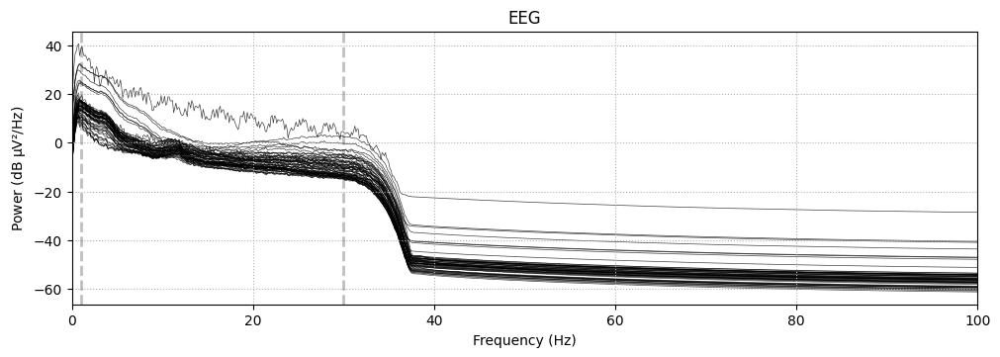

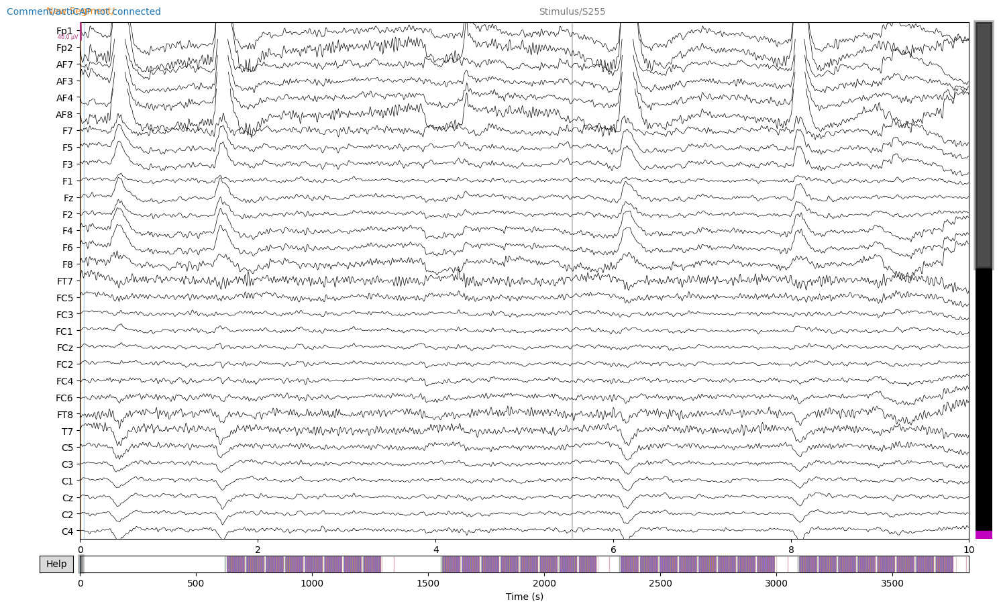

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 11.8s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 H

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 4847 (average pulse 75.92739110348266 / min.)
Not setting metadata
4847 matching events found
No baseline correction applied
Using data from preloaded Raw for 4847 events and 257 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


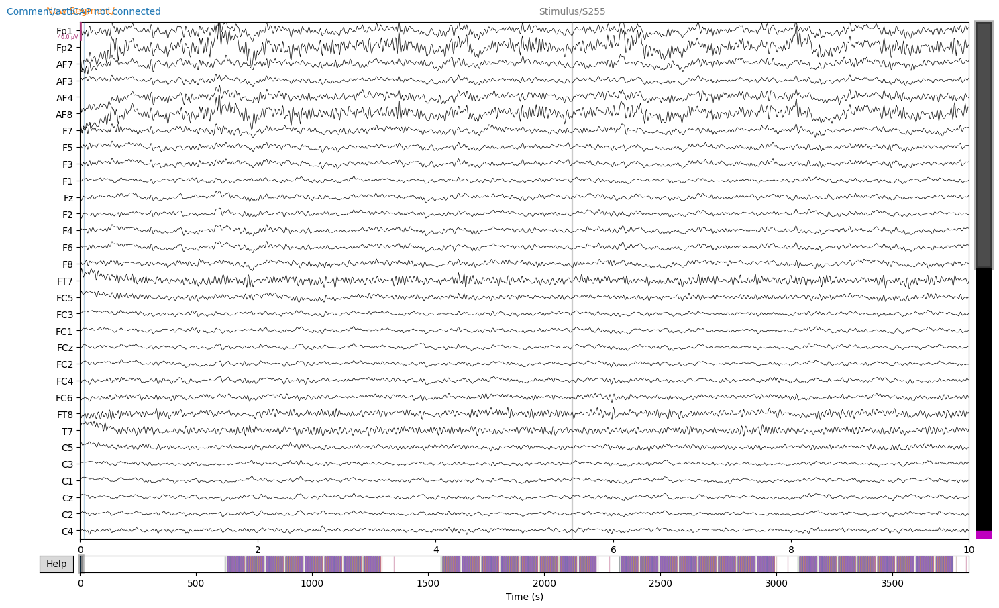

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:44:30,311 - INFO - Processing subject: sub-STSWD1120


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1120/eeg/sub-STSWD1120_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3115999  =      0.000 ...  3115.999 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.6s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


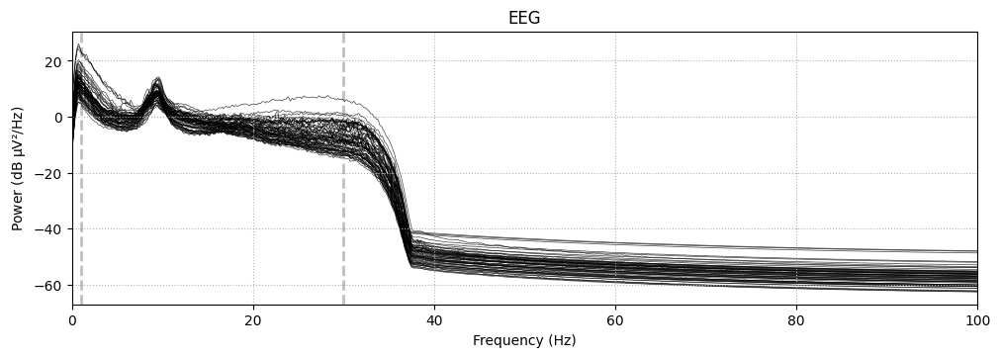

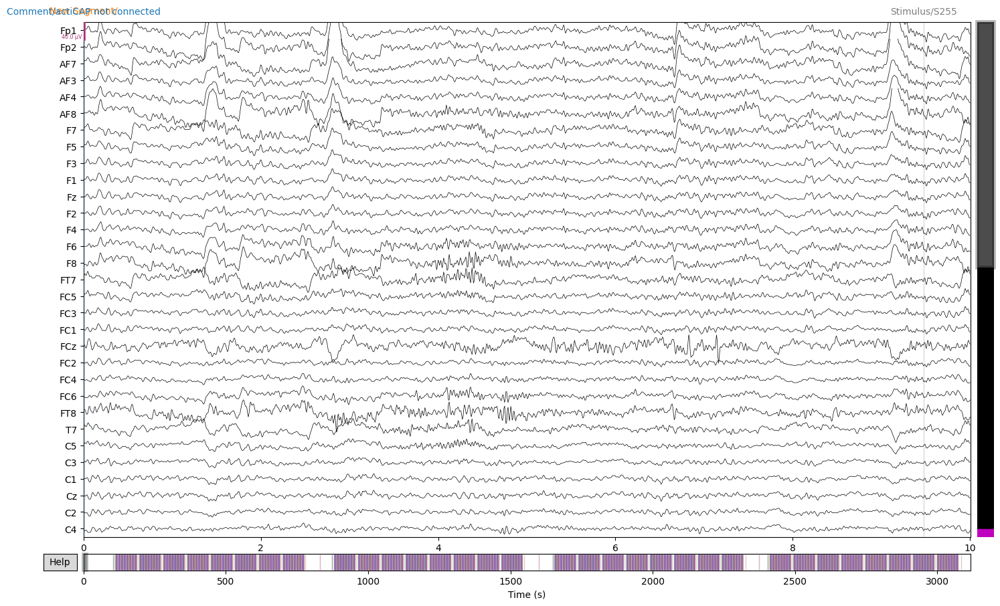

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 9.0s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 2267 (average pulse 43.65211810012837 / min.)
Not setting metadata
2267 matching events found
No baseline correction applied
Using data from preloaded Raw for 2267 events and 257 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


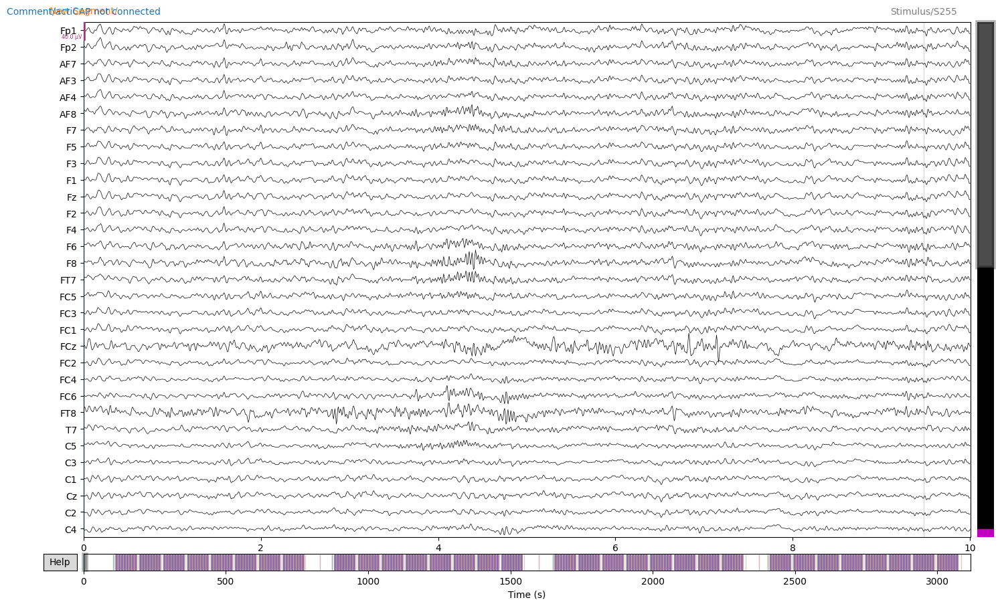

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:45:53,401 - INFO - Processing subject: sub-STSWD1126


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1126/eeg/sub-STSWD1126_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3185959  =      0.000 ...  3185.959 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.5s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


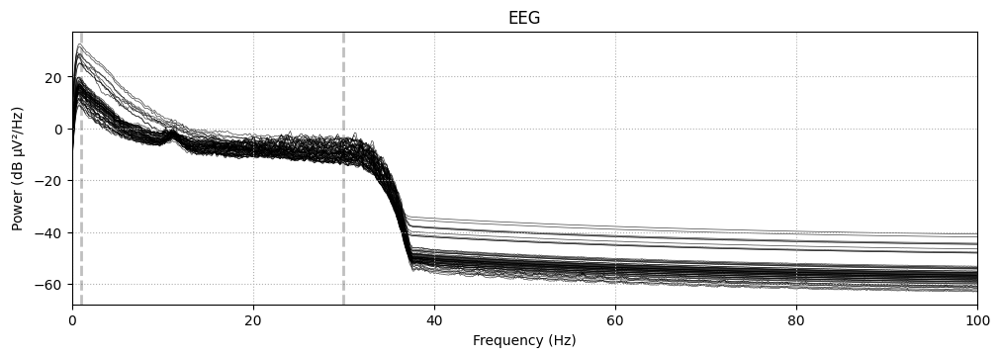

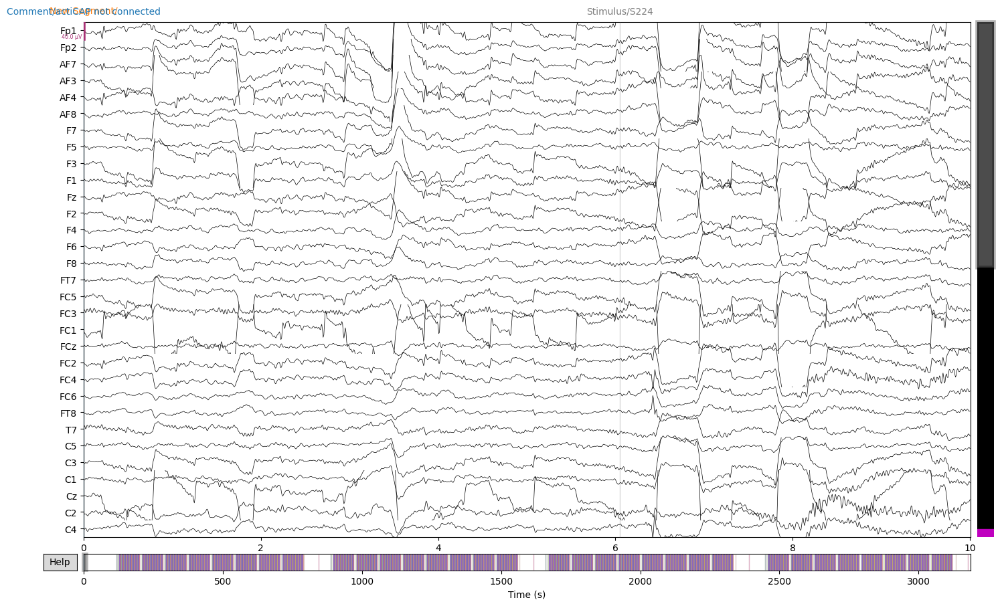

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 11.2s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 3635 (average pulse 68.45658320316427 / min.)
Not setting metadata
3635 matching events found
No baseline correction applied
Using data from preloaded Raw for 3635 events and 257 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 6 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


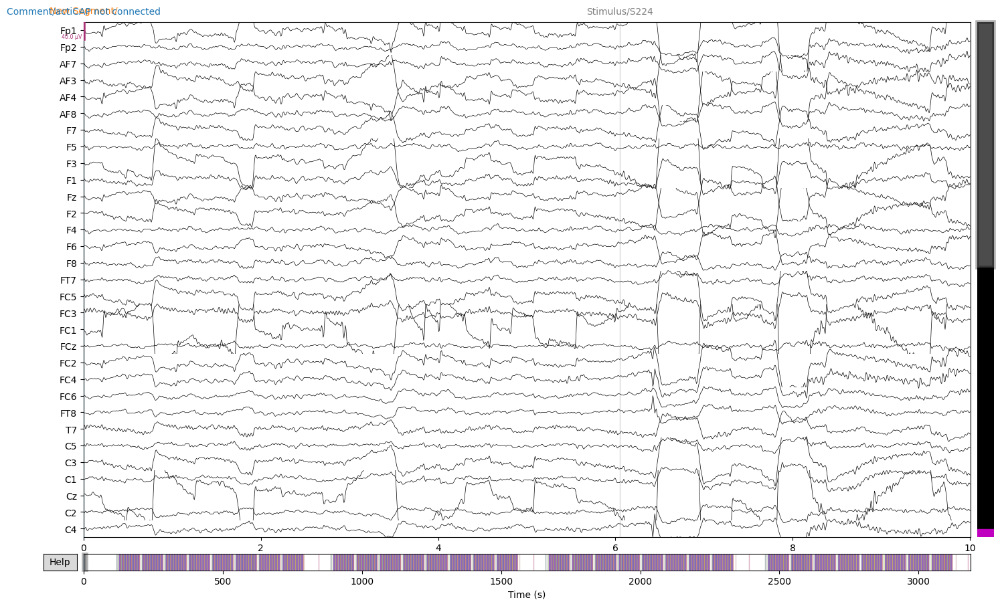

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:47:14,563 - INFO - Processing subject: sub-STSWD1131


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1131/eeg/sub-STSWD1131_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3287279  =      0.000 ...  3287.279 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.5s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


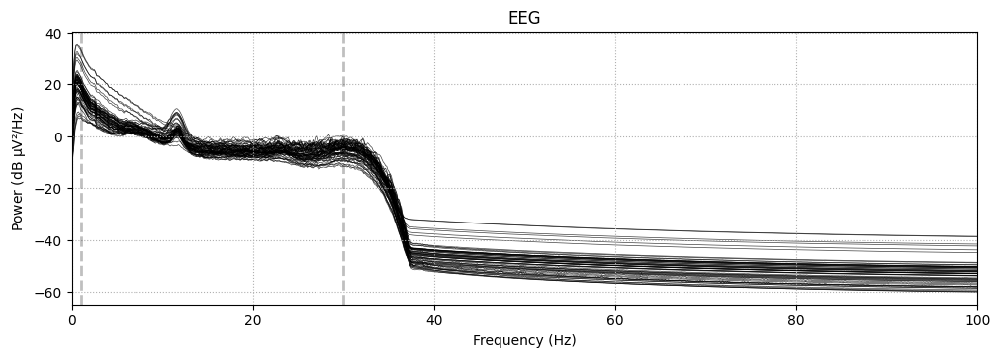

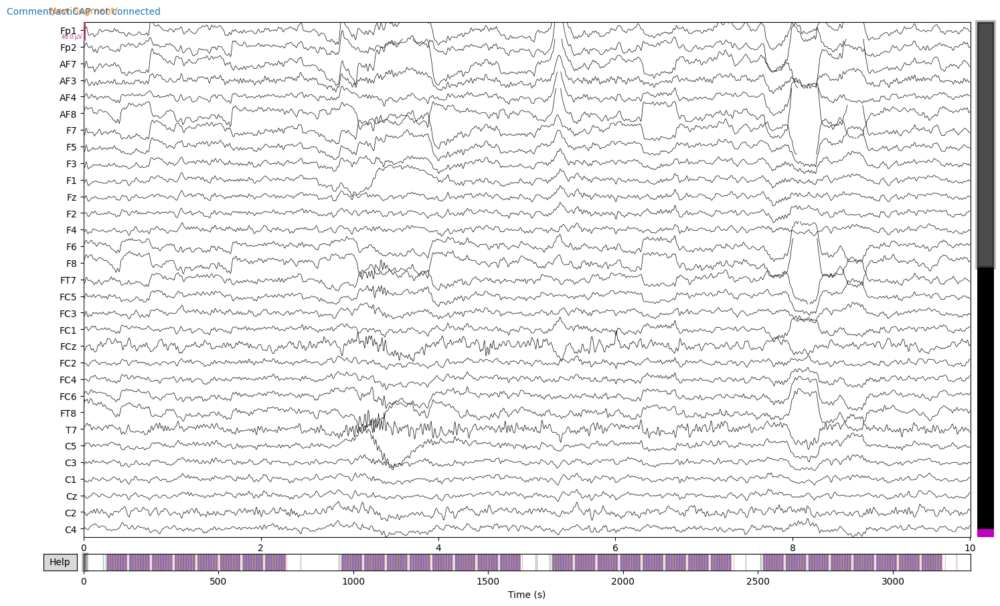

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 12.5s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 4765 (average pulse 86.97156654910498 / min.)
Not setting metadata
4765 matching events found
No baseline correction applied
Using data from preloaded Raw for 4765 events and 257 original time points ...
0 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


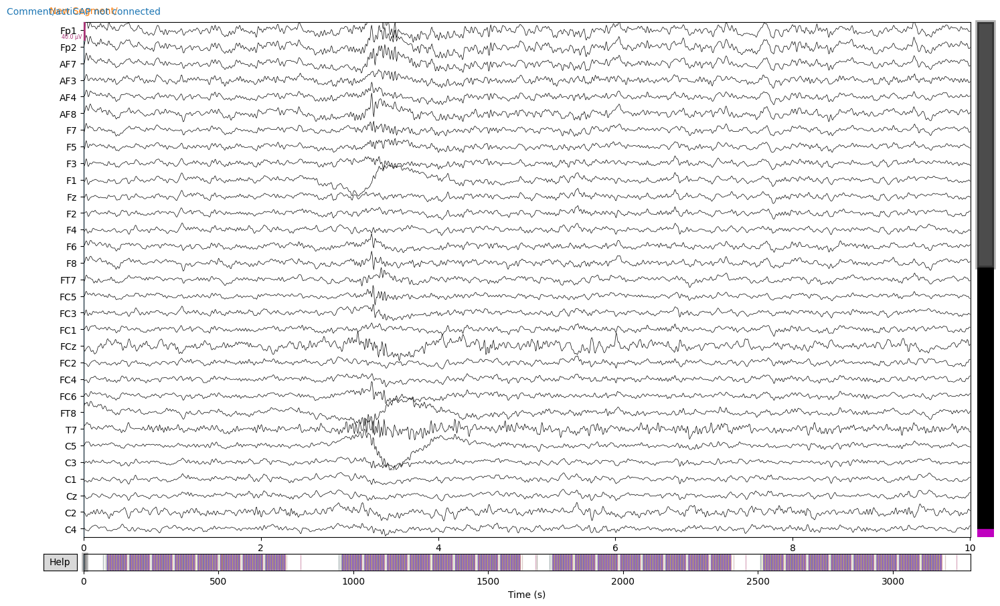

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:48:40,454 - INFO - Processing subject: sub-STSWD1132


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1132/eeg/sub-STSWD1132_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3129919  =      0.000 ...  3129.919 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.5s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


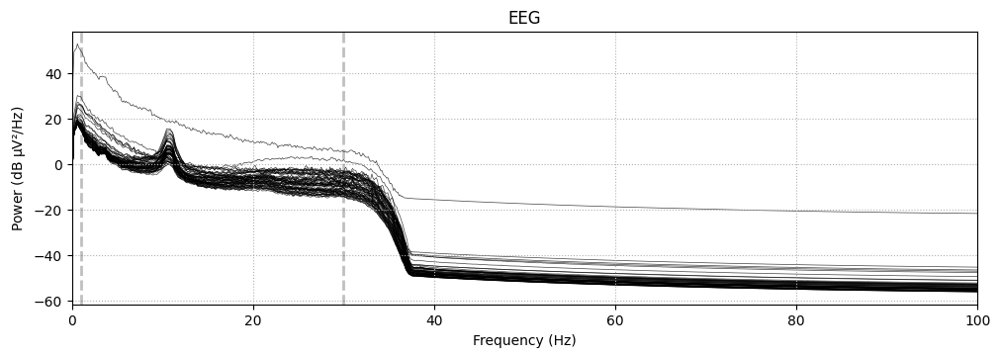

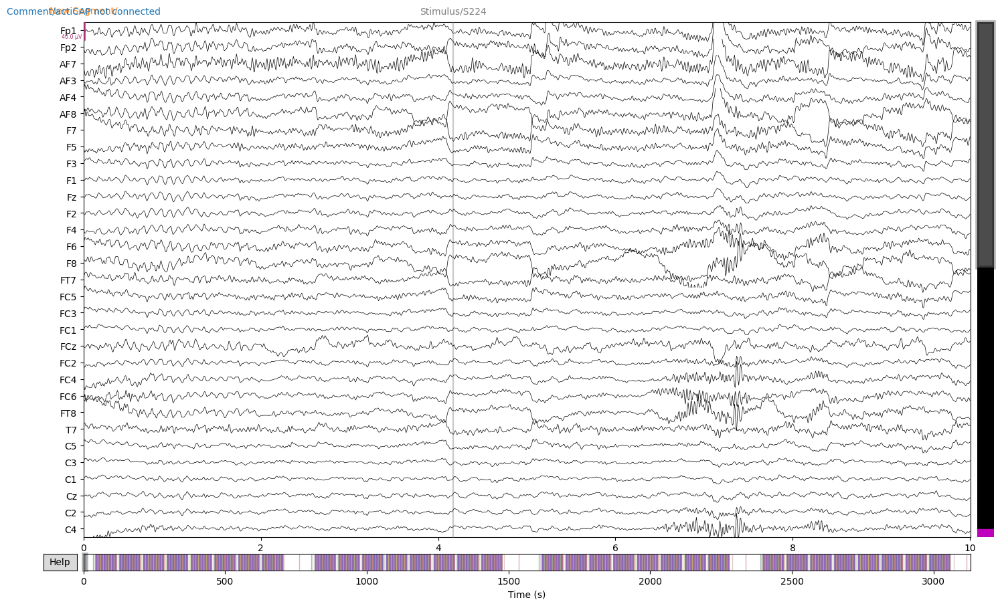

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 7.7s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 3666 (average pulse 70.27651448967875 / min.)
Not setting metadata
3666 matching events found
No baseline correction applied
Using data from preloaded Raw for 3666 events and 257 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


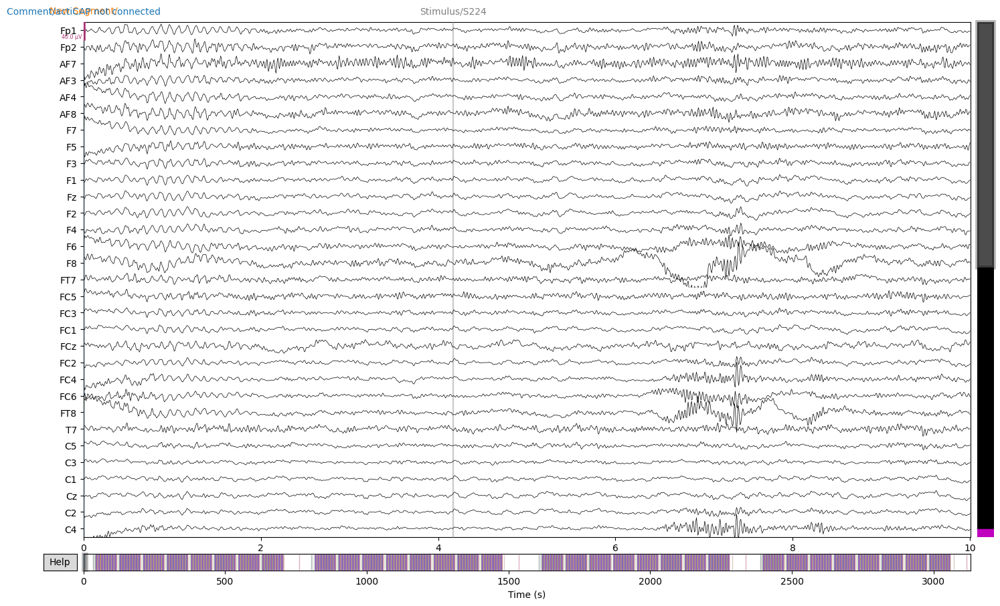

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:50:01,535 - INFO - Processing subject: sub-STSWD1135


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1135/eeg/sub-STSWD1135_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3071679  =      0.000 ...  3071.679 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.5s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


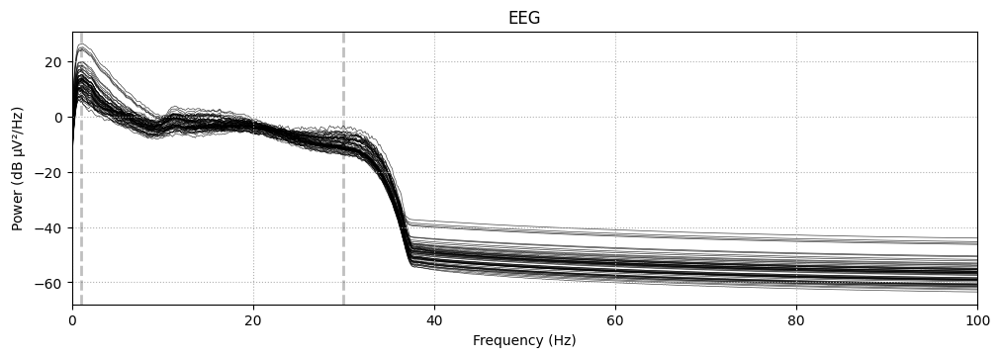

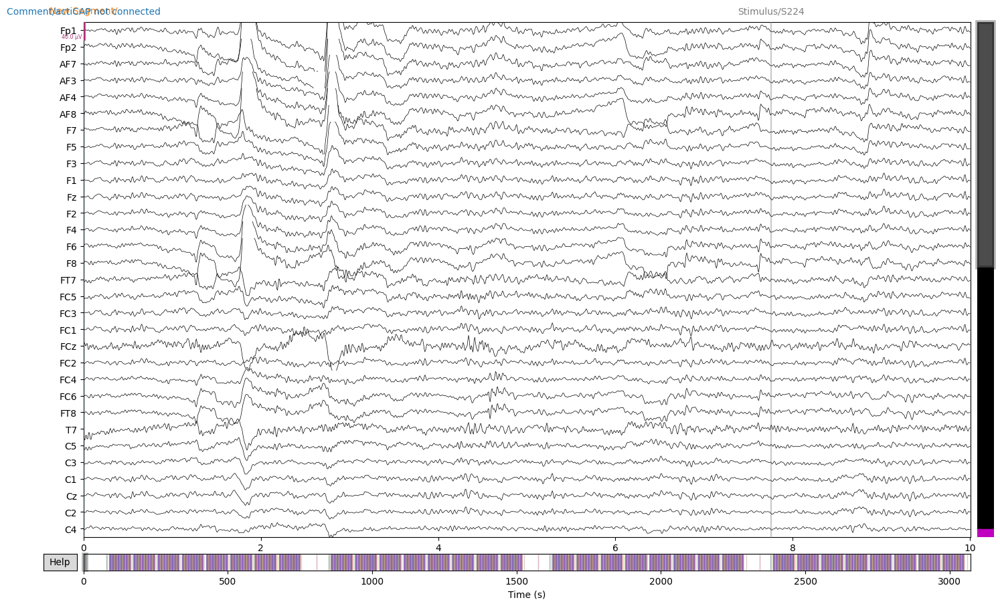

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 9.3s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished


Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)



[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 3385 (average pulse 66.12017549437273 / min.)
Not setting metadata
3385 matching events found
No baseline correction applied
Using data from preloaded Raw for 3385 events and 257 original time points ...
0 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 5 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


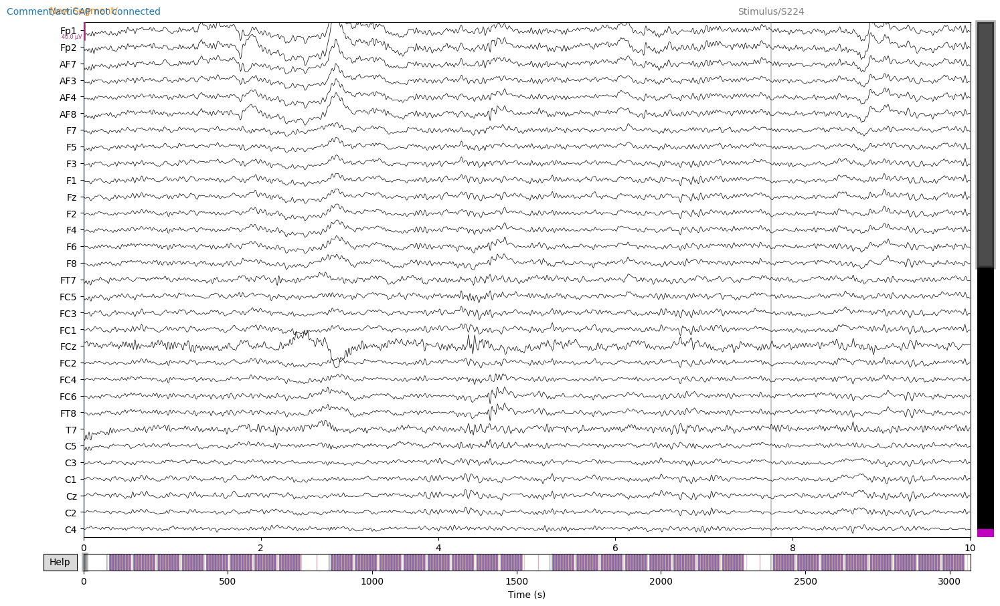

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:51:23,387 - INFO - Processing subject: sub-STSWD1164


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1164/eeg/sub-STSWD1164_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3349679  =      0.000 ...  3349.679 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.8s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


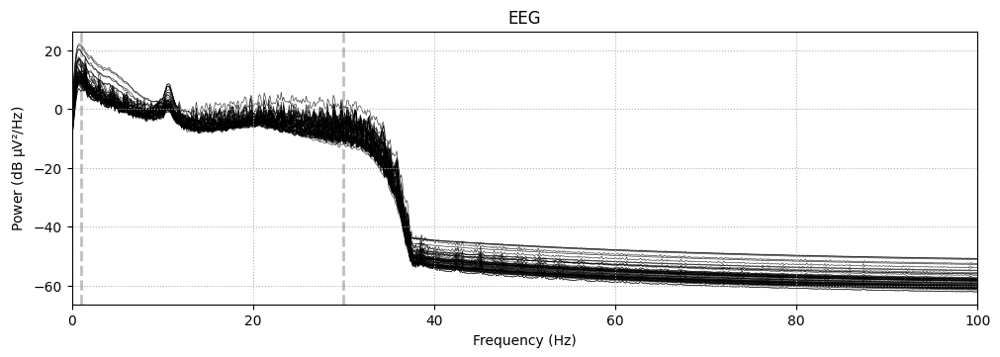

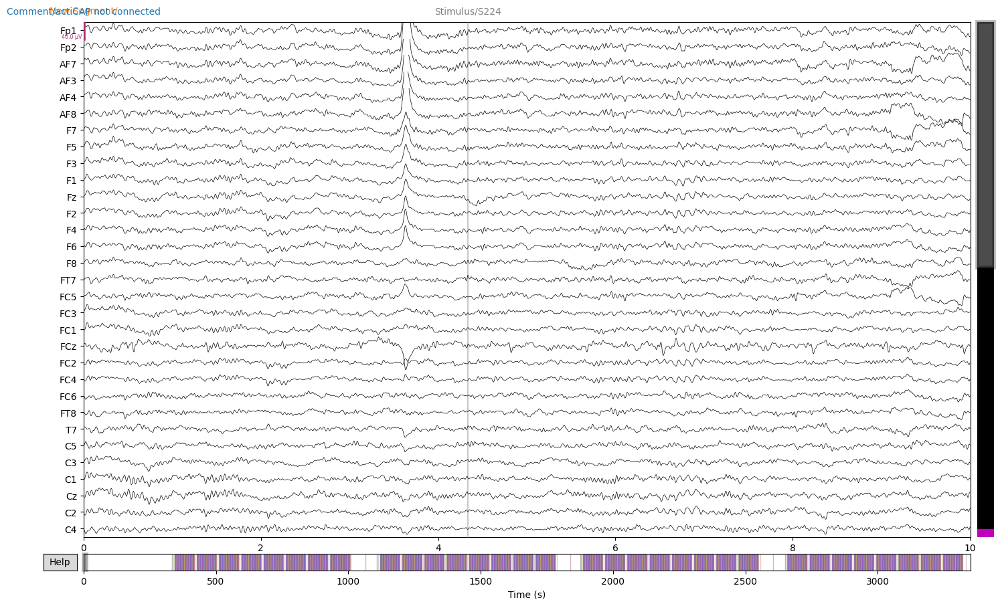

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 11.4s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 4025 (average pulse 72.09644578889306 / min.)
Not setting metadata
4025 matching events found
No baseline correction applied
Using data from preloaded Raw for 4025 events and 257 original time points ...
0 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 4 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


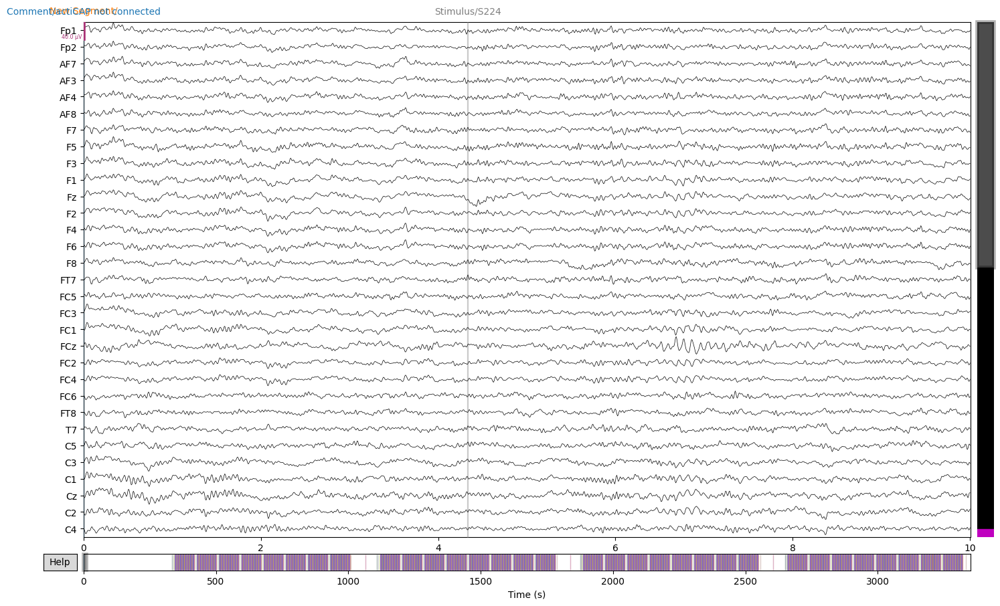

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:52:44,584 - INFO - Processing subject: sub-STSWD1167


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1167/eeg/sub-STSWD1167_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3087439  =      0.000 ...  3087.439 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.5s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


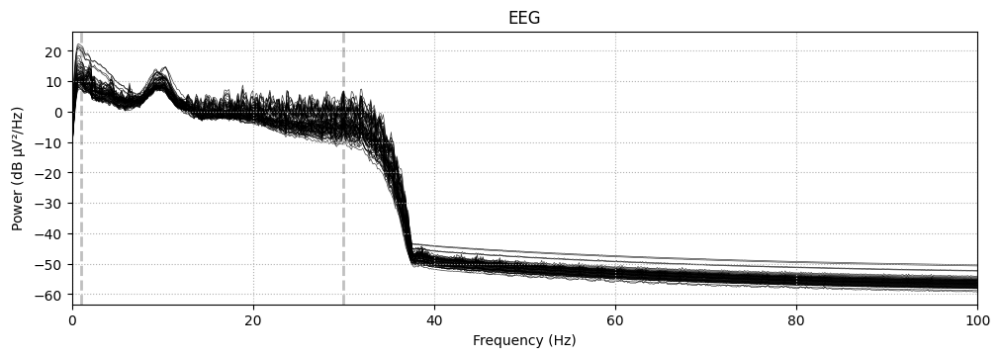

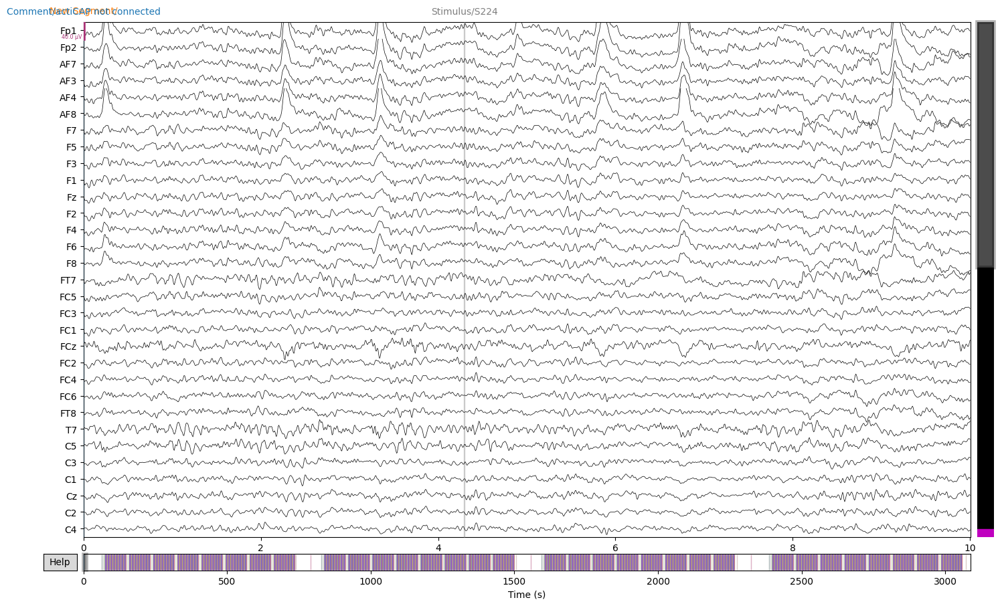

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 9.4s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 5033 (average pulse 97.80914364518557 / min.)
Not setting metadata
5033 matching events found
No baseline correction applied
Using data from preloaded Raw for 5033 events and 257 original time points ...
0 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 2 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


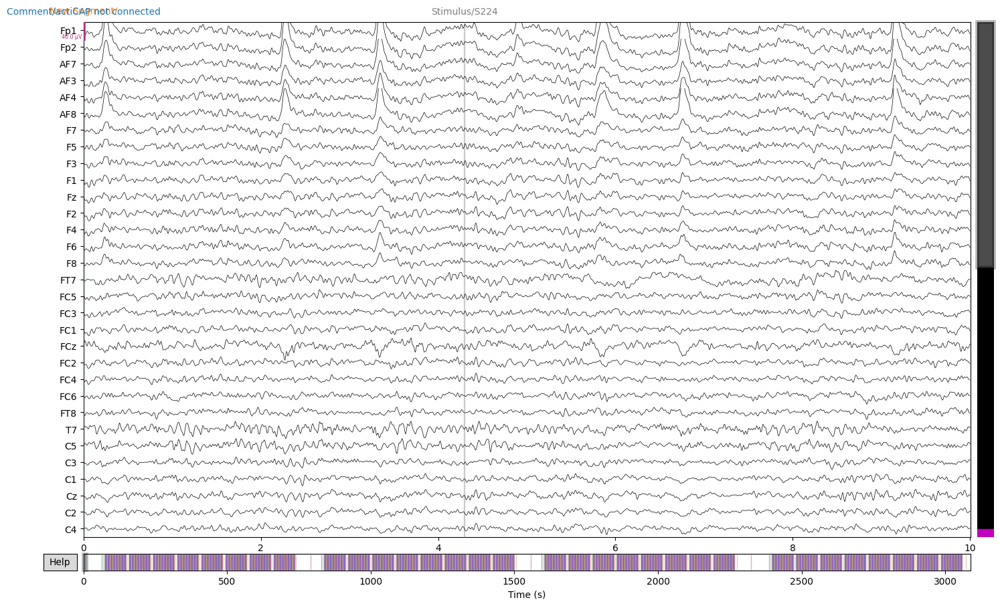

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:54:07,742 - INFO - Processing subject: sub-STSWD1215


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1215/eeg/sub-STSWD1215_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3137519  =      0.000 ...  3137.519 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.5s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


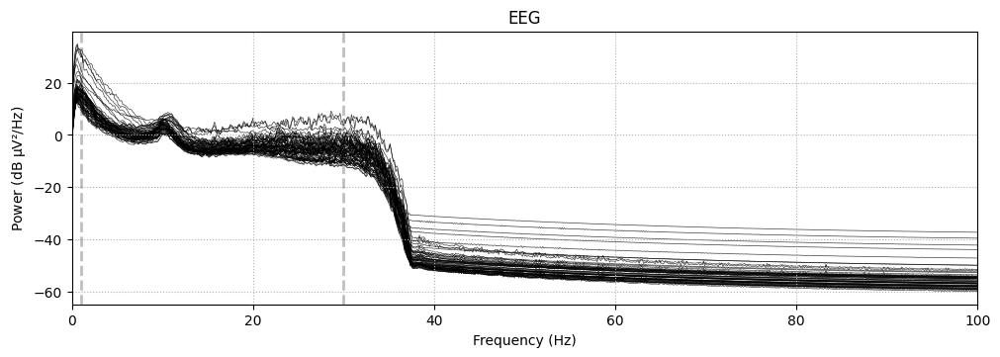

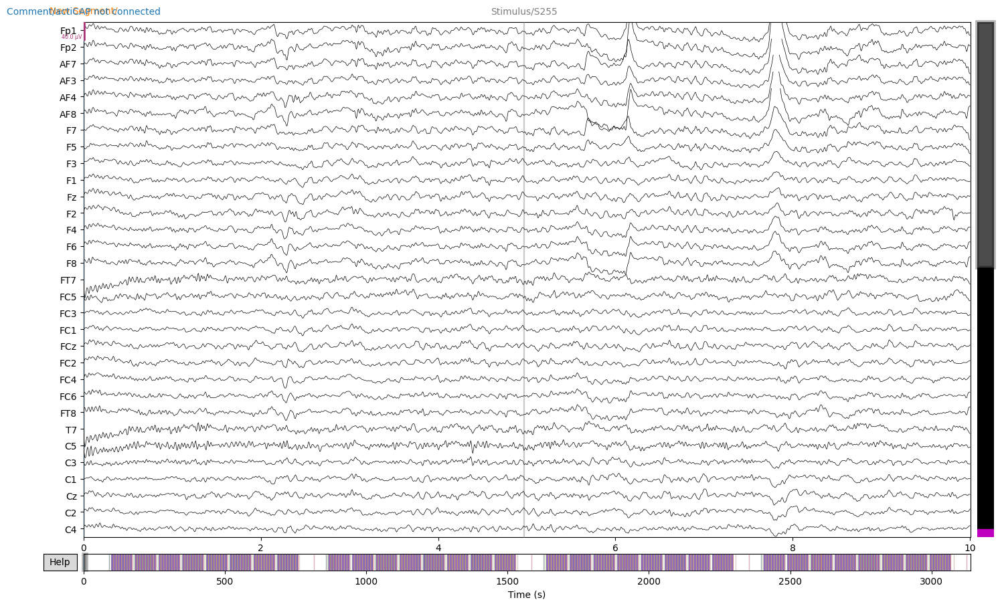

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 12.3s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 H

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 2938 (average pulse 56.184510803593106 / min.)
Not setting metadata
2938 matching events found
No baseline correction applied
Using data from preloaded Raw for 2938 events and 257 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 2 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


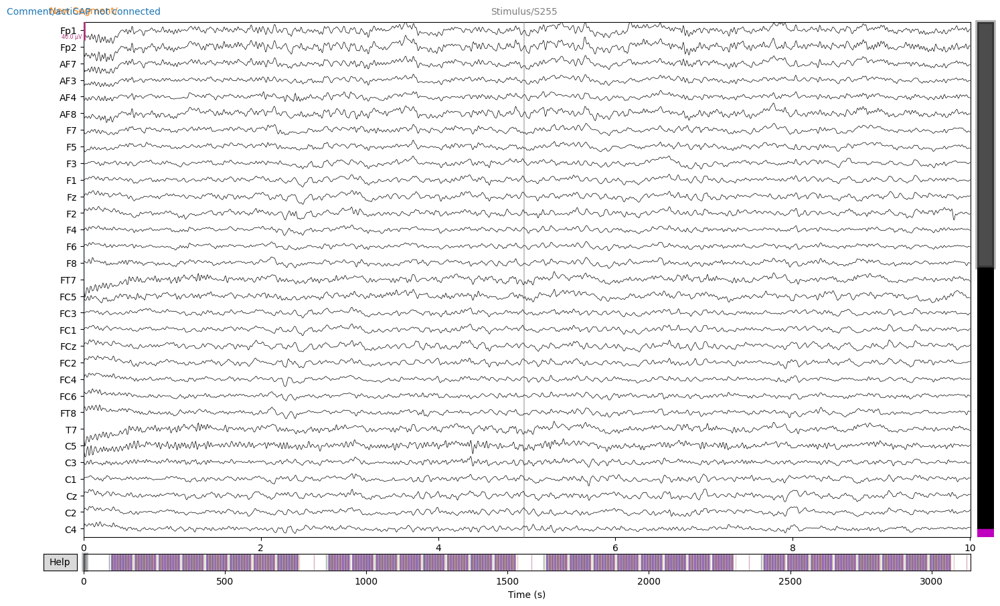

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:55:33,529 - INFO - Processing subject: sub-STSWD1216


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1216/eeg/sub-STSWD1216_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3573399  =      0.000 ...  3573.399 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.8s finished


Effective window size : 8.000 (s)
Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


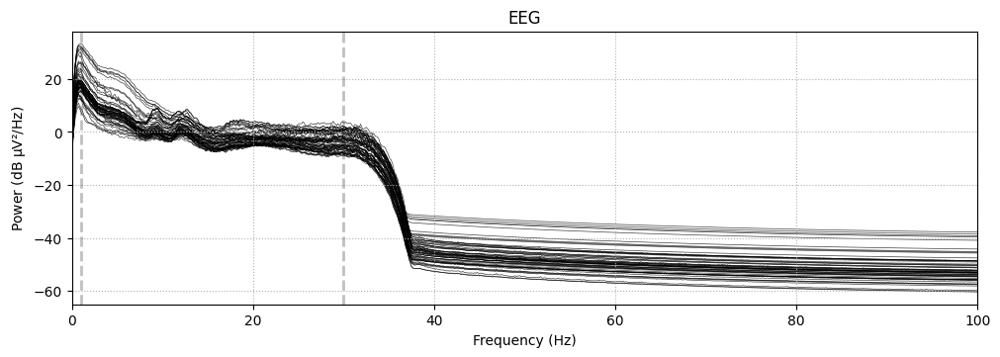

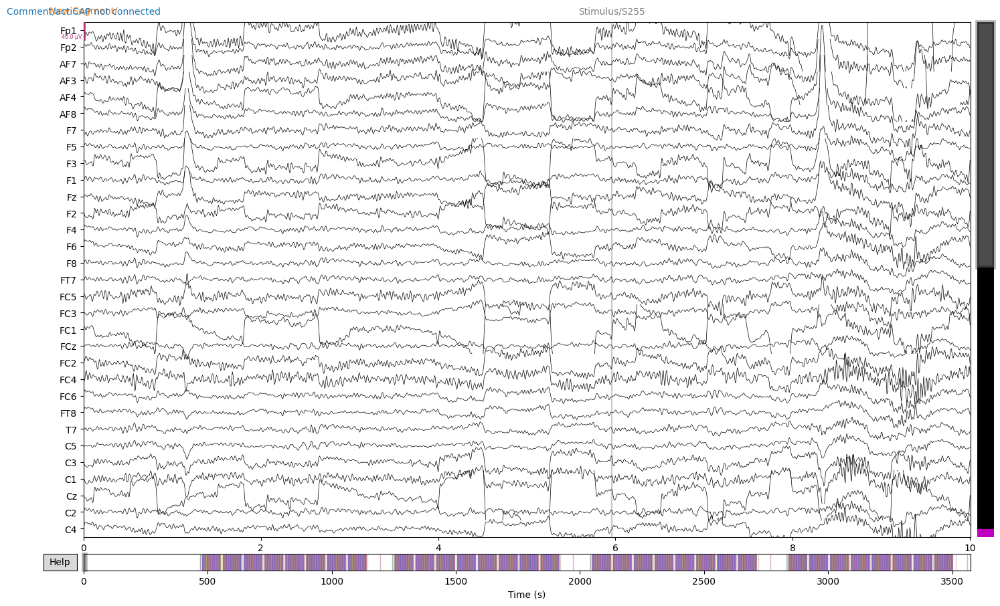

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 15.0s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 H

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 4604 (average pulse 77.30456170268586 / min.)
Not setting metadata
4604 matching events found
No baseline correction applied
Using data from preloaded Raw for 4604 events and 257 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 2 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


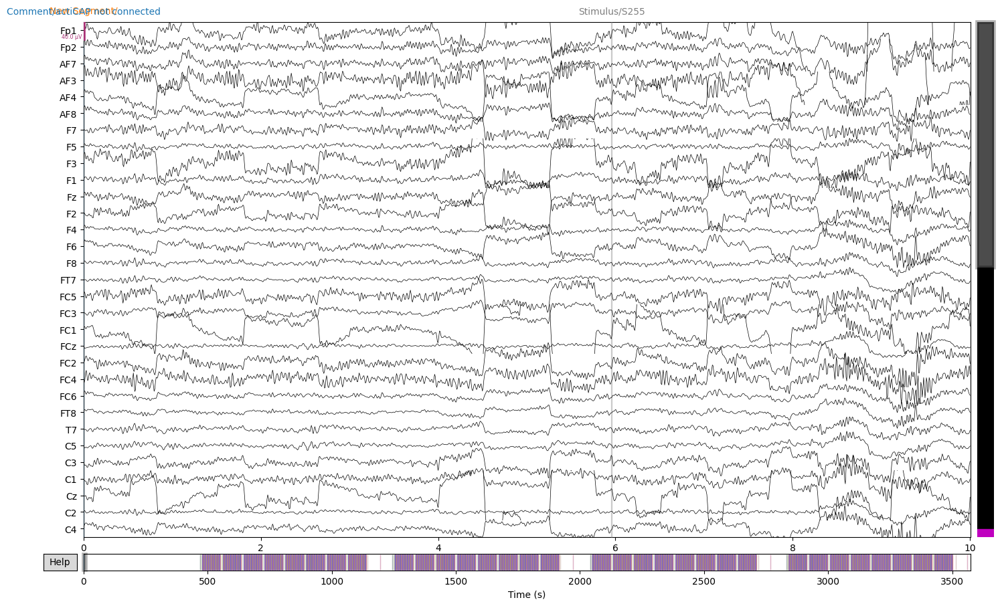

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:57:02,047 - INFO - Processing subject: sub-STSWD1233


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1233/eeg/sub-STSWD1233_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3178279  =      0.000 ...  3178.279 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.7s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


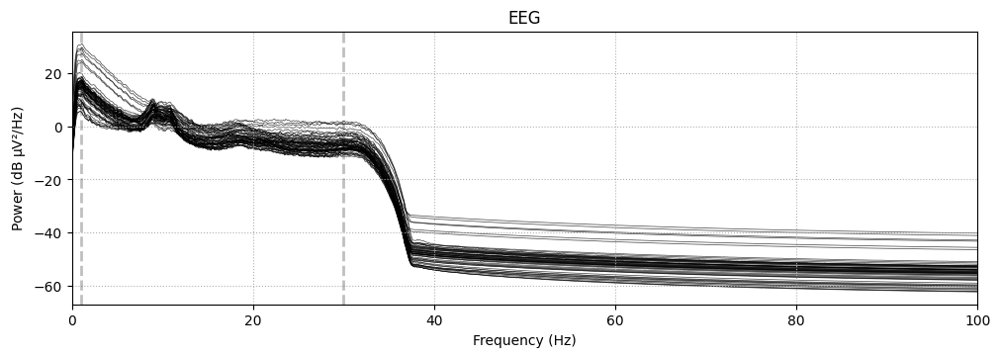

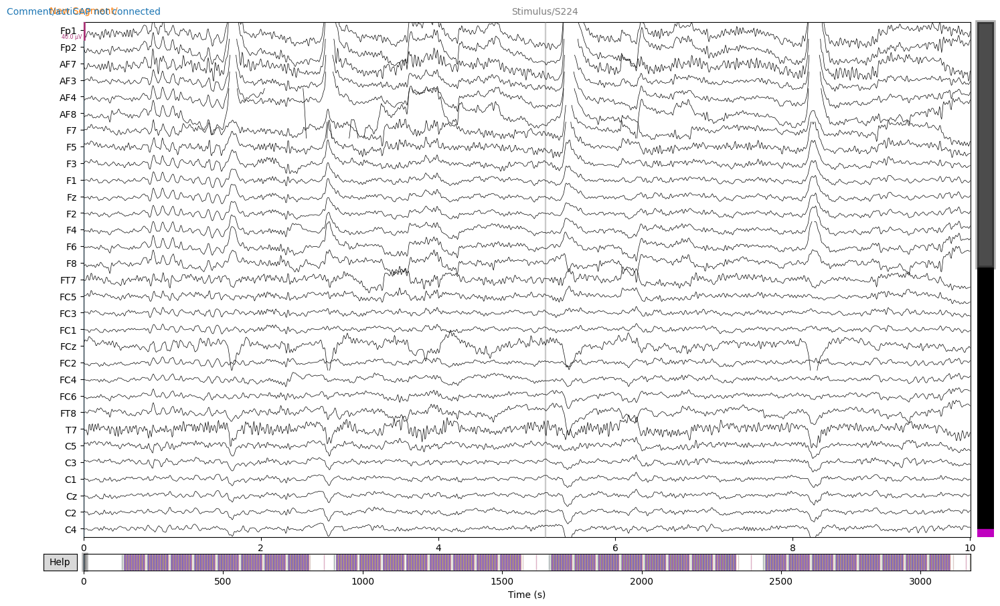

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 12.8s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 3808 (average pulse 71.88791111548105 / min.)
Not setting metadata
3808 matching events found
No baseline correction applied
Using data from preloaded Raw for 3808 events and 257 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


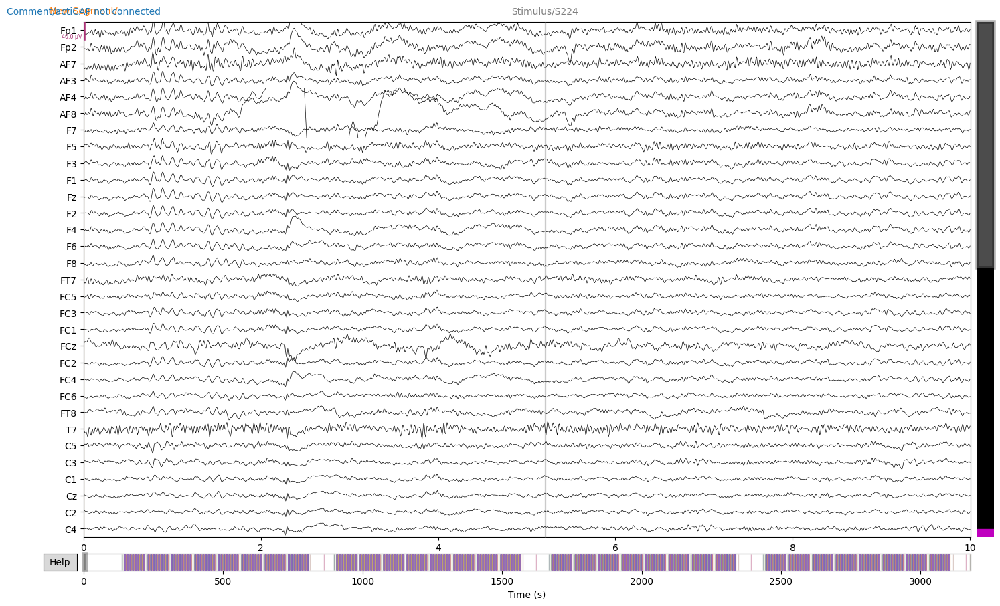

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:58:26,842 - INFO - Processing subject: sub-STSWD1234


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1234/eeg/sub-STSWD1234_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3173359  =      0.000 ...  3173.359 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.5s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


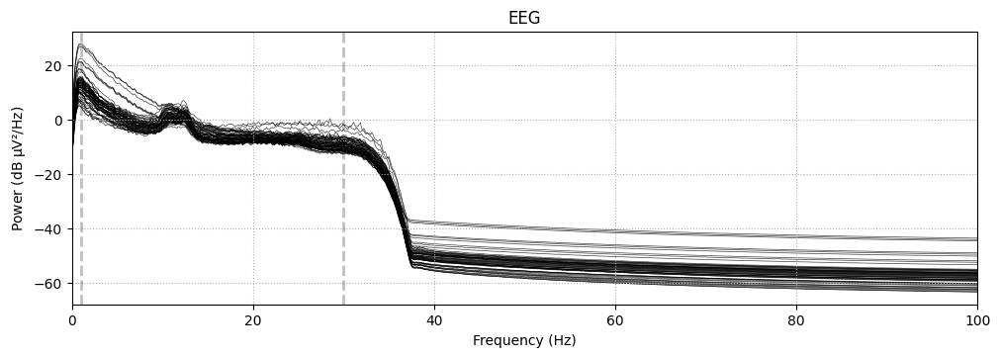

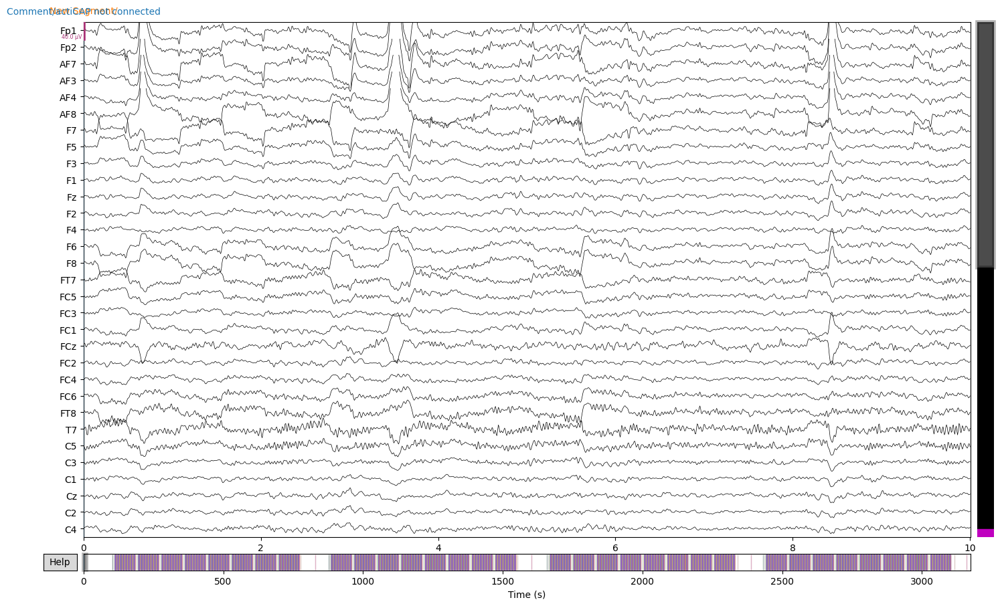

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 11.1s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 H

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 4123 (average pulse 77.95524262044856 / min.)
Not setting metadata
4123 matching events found
No baseline correction applied
Using data from preloaded Raw for 4123 events and 257 original time points ...
0 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 2 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


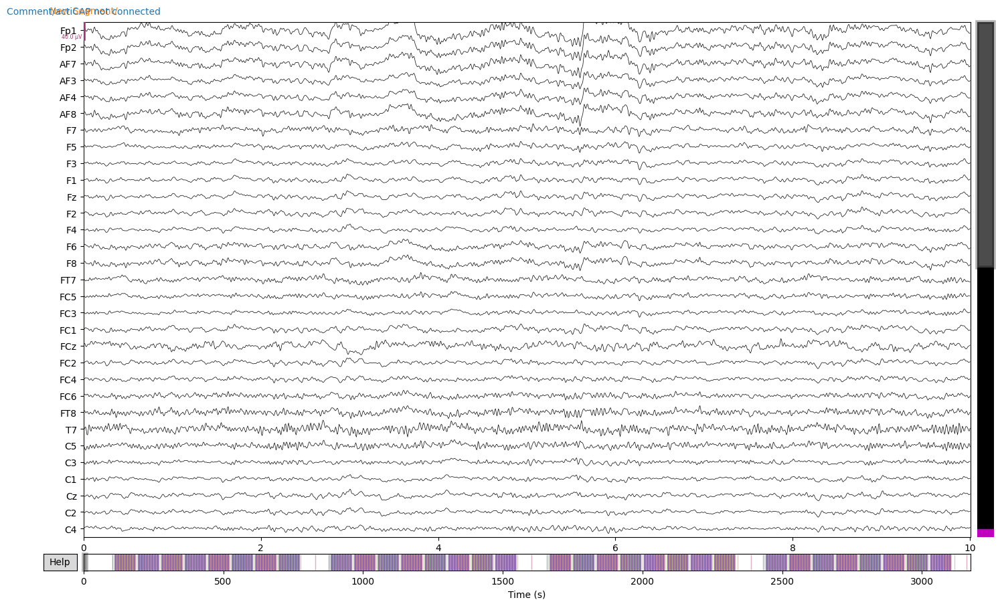

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 13:59:52,804 - INFO - Processing subject: sub-STSWD1240


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1240/eeg/sub-STSWD1240_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3398719  =      0.000 ...  3398.719 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.7s finished


Effective window size : 8.000 (s)
Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


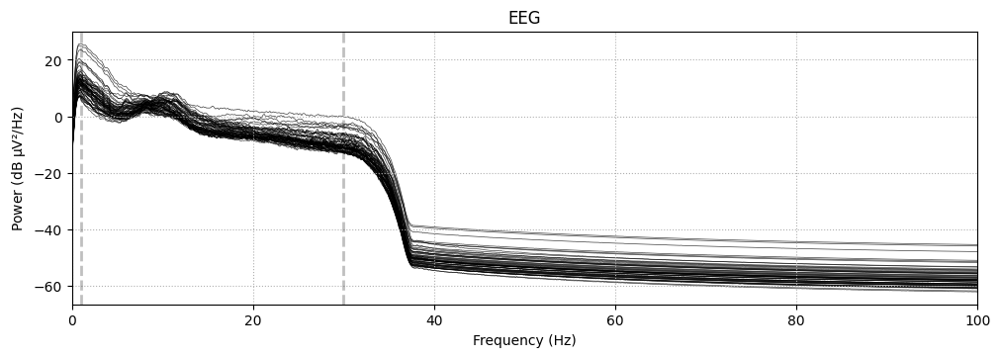

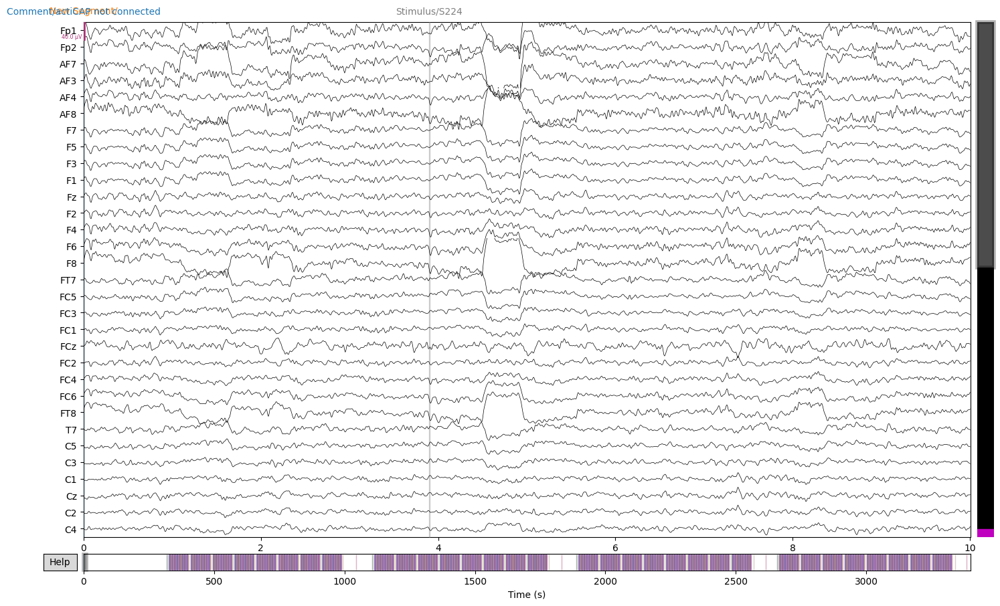

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 7.1s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 3787 (average pulse 66.85460513612666 / min.)
Not setting metadata
3787 matching events found
No baseline correction applied
Using data from preloaded Raw for 3787 events and 257 original time points ...
0 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 2 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


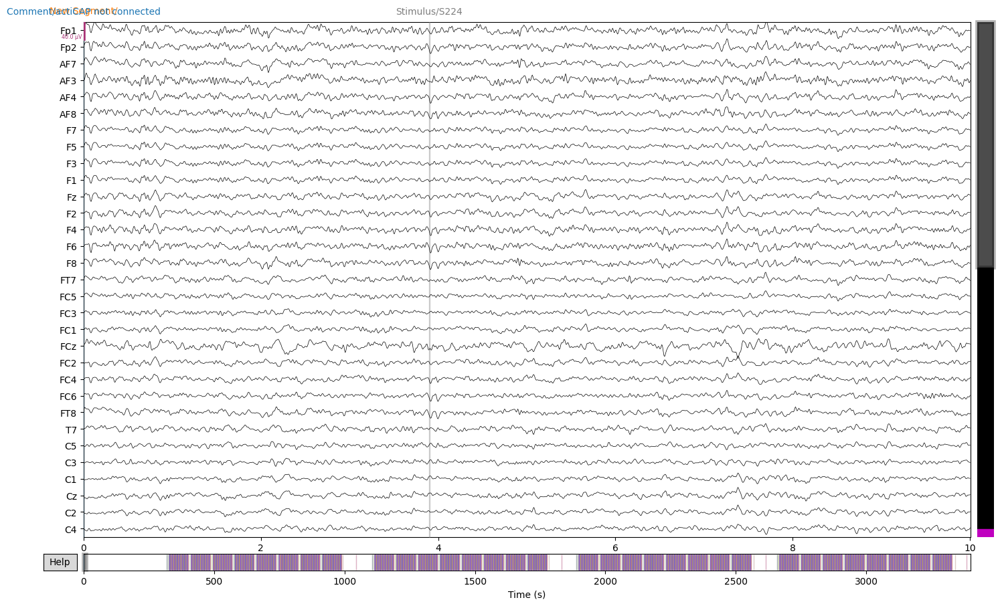

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 14:01:29,854 - INFO - Processing subject: sub-STSWD1250


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1250/eeg/sub-STSWD1250_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3206999  =      0.000 ...  3206.999 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.7s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


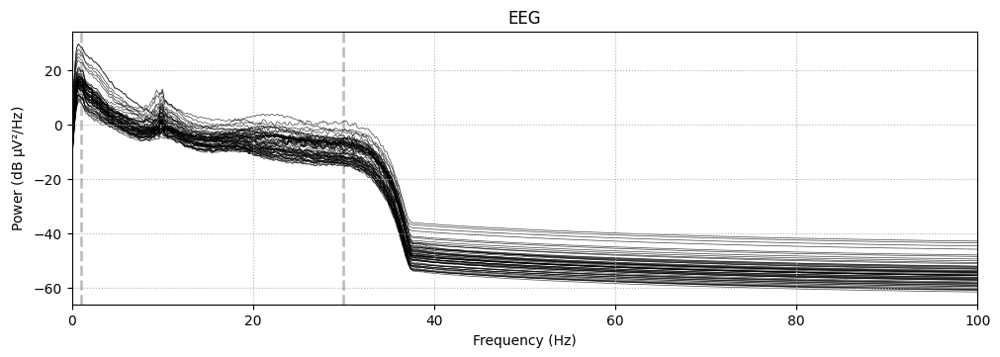

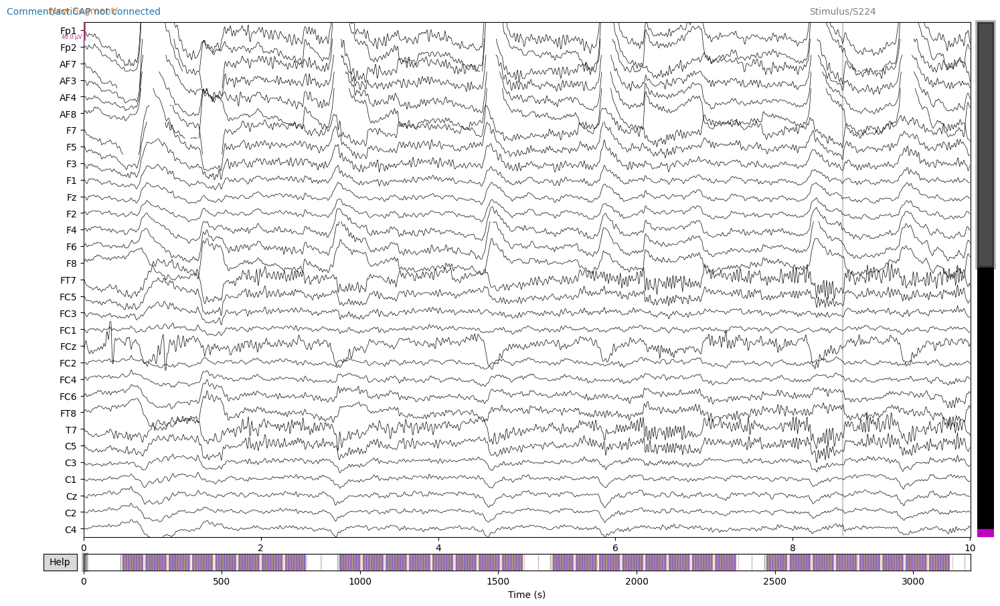

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 10.5s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 2455 (average pulse 45.93077642656688 / min.)
Not setting metadata
2455 matching events found
No baseline correction applied
Using data from preloaded Raw for 2455 events and 257 original time points ...
0 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


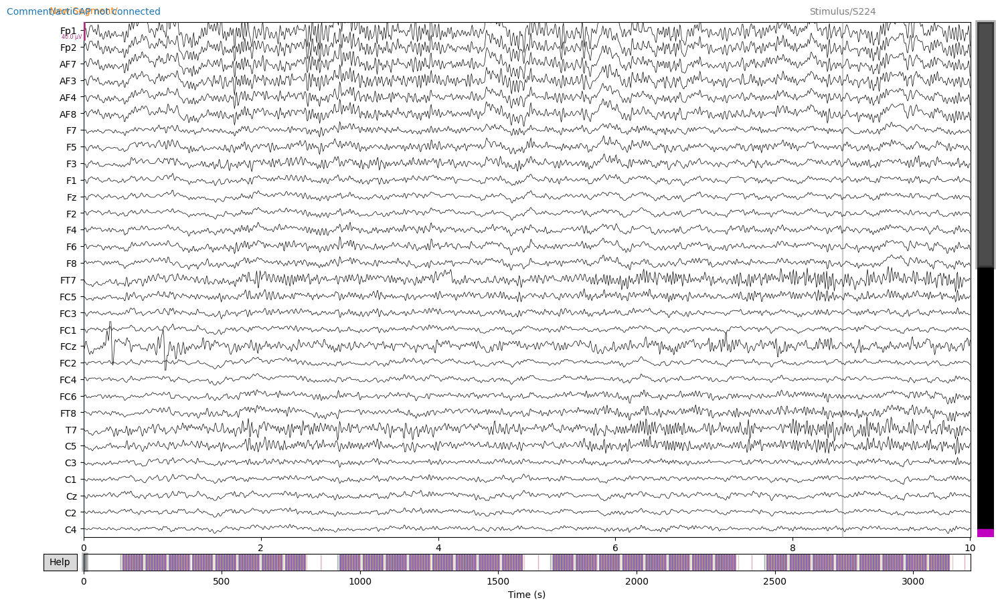

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 14:02:55,322 - INFO - Processing subject: sub-STSWD1261


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1261/eeg/sub-STSWD1261_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3500799  =      0.000 ...  3500.799 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.4s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.7s finished


Effective window size : 8.000 (s)
Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


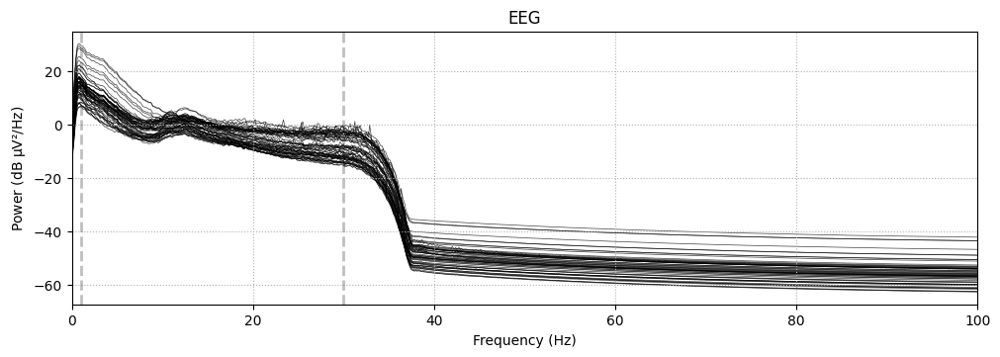

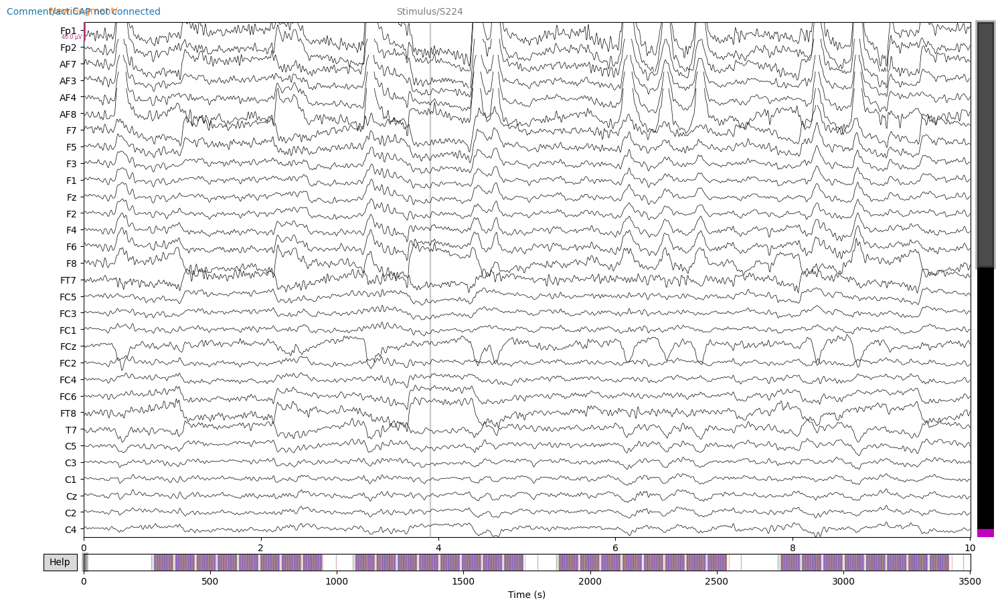

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 10.3s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 H

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 5140 (average pulse 88.09413024921753 / min.)
Not setting metadata
5140 matching events found
No baseline correction applied
Using data from preloaded Raw for 5140 events and 257 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


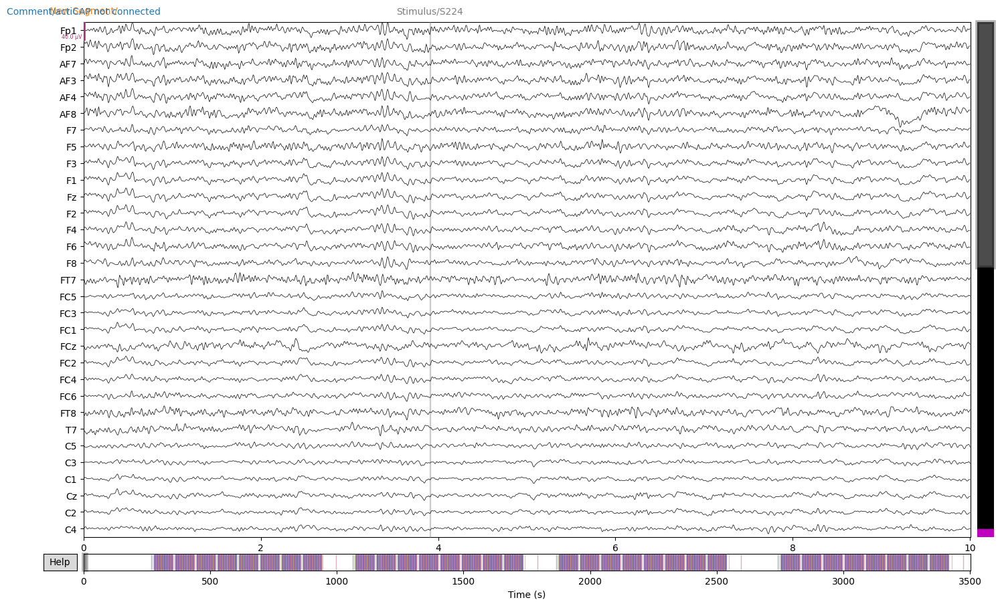

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 14:04:21,586 - INFO - Processing subject: sub-STSWD1266


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1266/eeg/sub-STSWD1266_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3058159  =      0.000 ...  3058.159 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.6s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


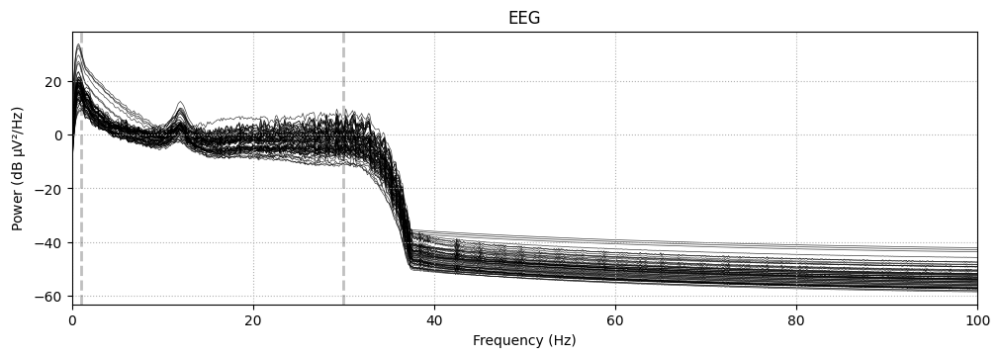

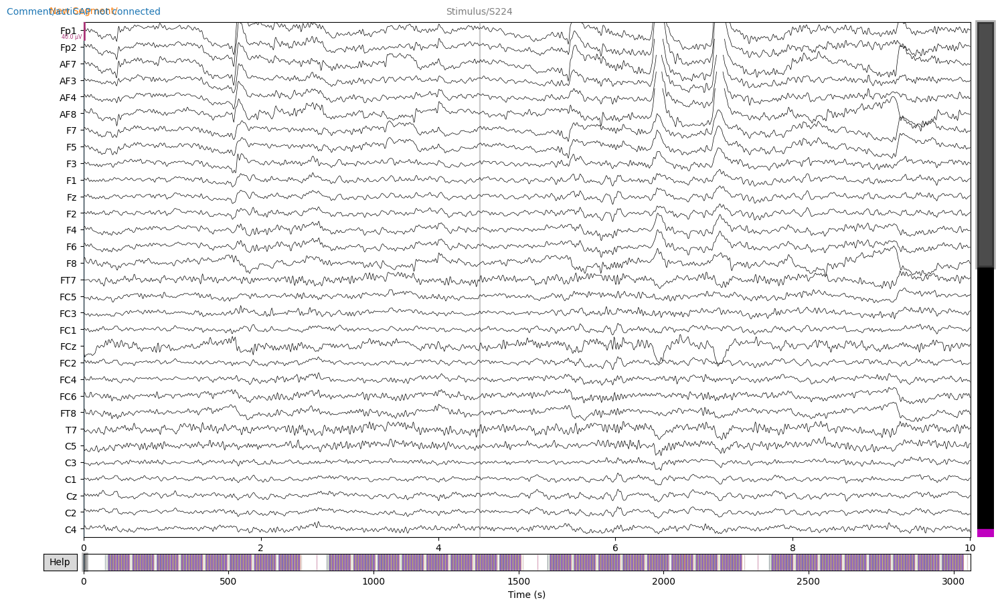

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 8.6s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 3507 (average pulse 68.80607595712803 / min.)
Not setting metadata
3507 matching events found
No baseline correction applied
Using data from preloaded Raw for 3507 events and 257 original time points ...
2 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


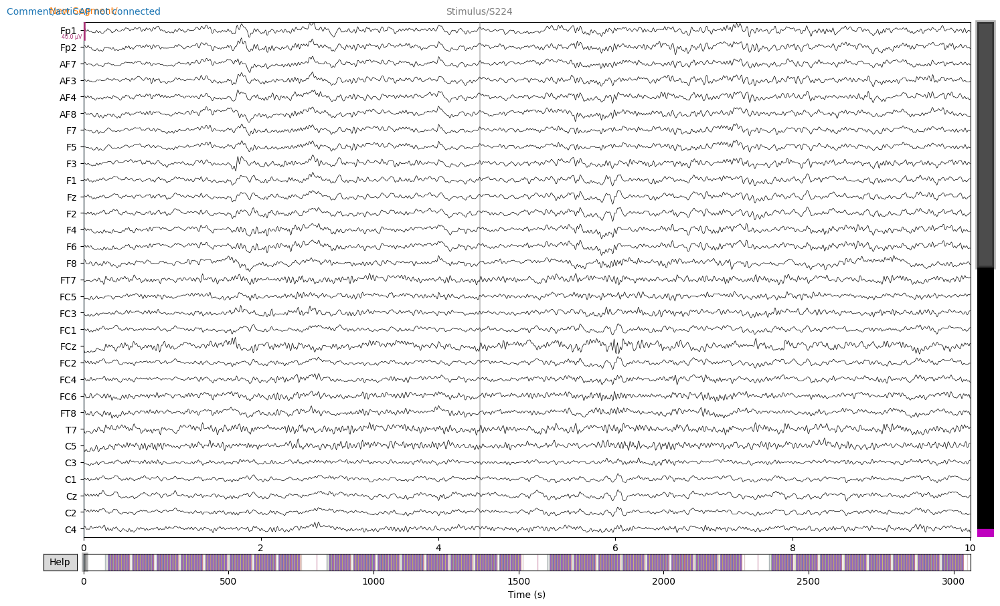

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 14:05:41,376 - INFO - Processing subject: sub-STSWD1270


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1270/eeg/sub-STSWD1270_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3116919  =      0.000 ...  3116.919 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.5s finished


Effective window size : 8.000 (s)
Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


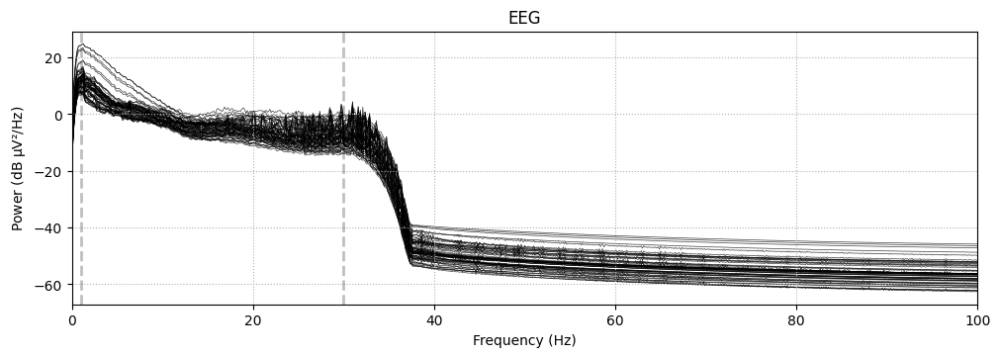

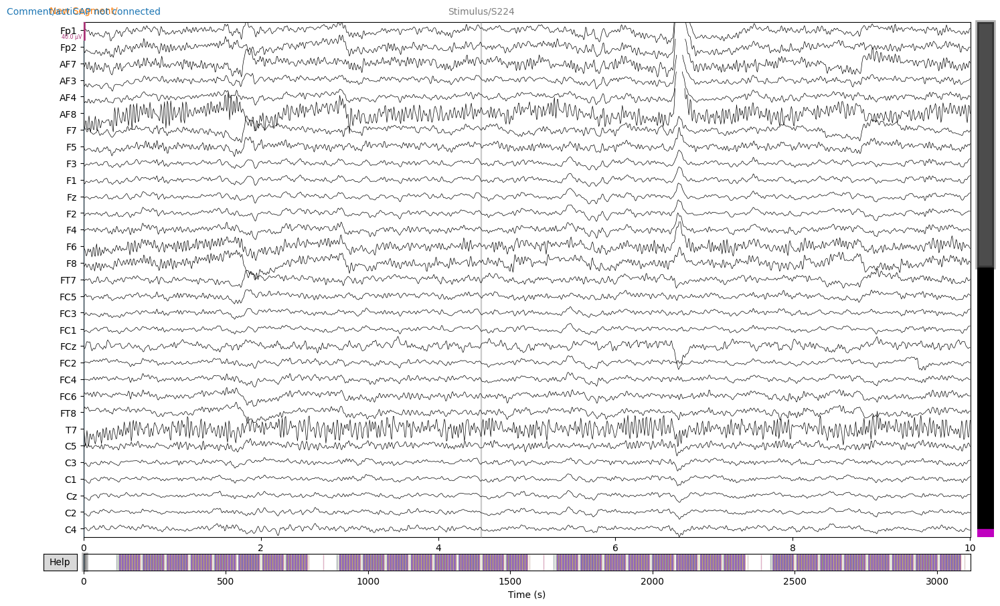

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components
Fitting ICA took 11.7s.
Using EOG channels: VEOG, HEOGL, HEOGR


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 3917 (average pulse 75.4013123925347 / min.)
Not setting metadata
3917 matching events found
No baseline correction applied
Using data from preloaded Raw for 3917 events and 257 original time points ...
2 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 3 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


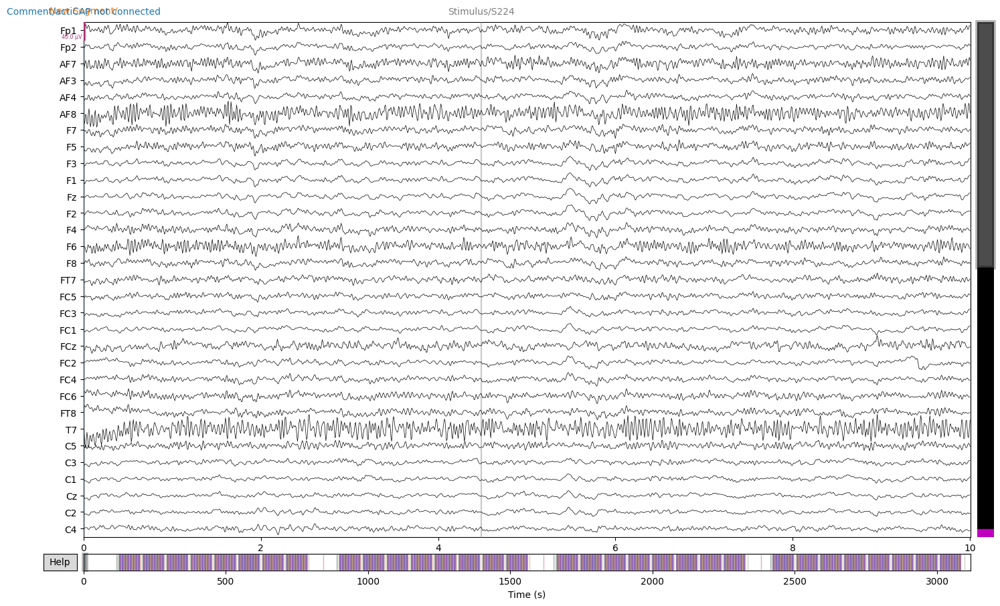

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(
2025-12-11 14:07:05,349 - INFO - Processing subject: sub-STSWD1281


Extracting parameters from /volumes/hyijie_psy/CPP/test_low_Ko/sub-STSWD1281/eeg/sub-STSWD1281_task-dynamic_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3081799  =      0.000 ...  3081.799 secs...


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:30: RuntimeWarning: Channels contain different lowpass filters. Highest (weakest) filter setting (500.00 Hz, Nyquist limit) will be stored.
  eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 845 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Effective window size : 8.000 (s)


[Parallel(n_jobs=1)]: Done  61 out of  61 | elapsed:    0.6s finished


Plotting power spectral density (dB=True).


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:47: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/viz/utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


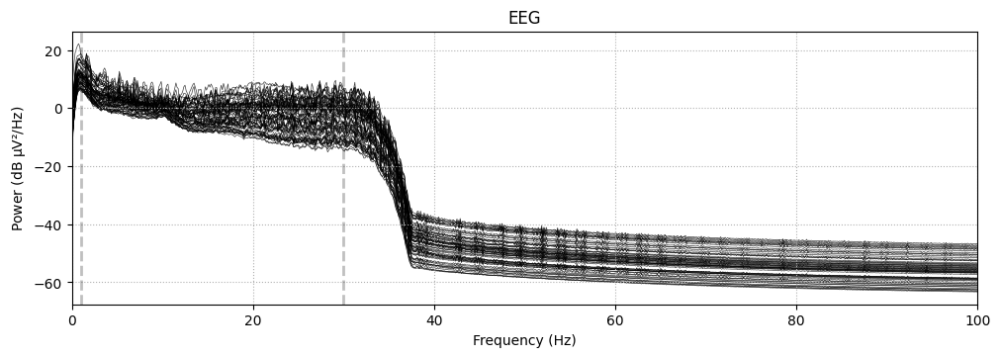

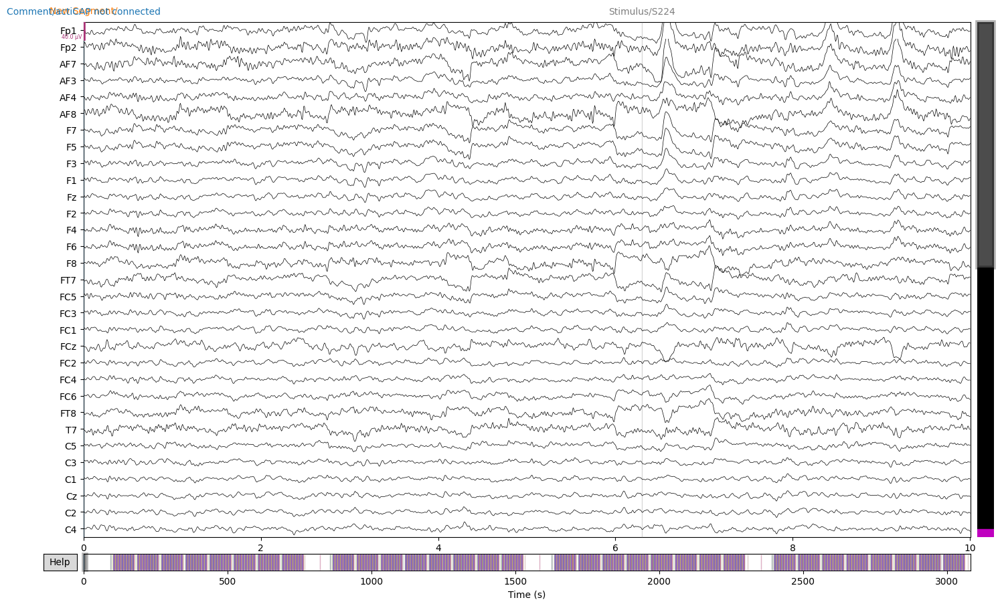

Fitting ICA to data using 61 channels (please be patient, this may take a while)
Selecting by number: 30 components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: divide by zero encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: overflow encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/scipy/linalg/_basic.py:1622: RuntimeWarning: invalid value encountered in matmul
  B = (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: divide by zero encountered in matmul
  return (u @ vh[:rank]).conj().T
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/utils/linalg.py:243: RuntimeWarning: overflow encountered in matmul
  return (u @ vh[:rank]).conj().T
/User

Fitting ICA took 12.8s.
Using EOG channels: VEOG, HEOGL, HEOGR
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 H

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 samples (10.000 s)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2560 sam

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Using threshold: 0.32 for CTPS ECG detection
Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 2560 samples (10.000 s)

Number of ECG events detected : 4286 (average pulse 83.44471893335496 / min.)
Not setting metadata
4286 matching events found
No baseline correction applied
Using data from preloaded Raw for 4286 events and 257 original time points ...
0 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (30 components)
    Zeroing out 2 ICA components
    Projecting back using 61 PCA components


/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: divide by zero encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: overflow encountered in matmul
  mixing = pca_components.T @ mixing
/Users/hyijie/Desktop/桌面文件夹/Lab/CPP_Multiverse_stage2/.venv/lib/python3.13/site-packages/mne/preprocessing/ica.py:2401: RuntimeWarning: invalid value encountered in matmul
  mixing = pca_components.T @ mixing


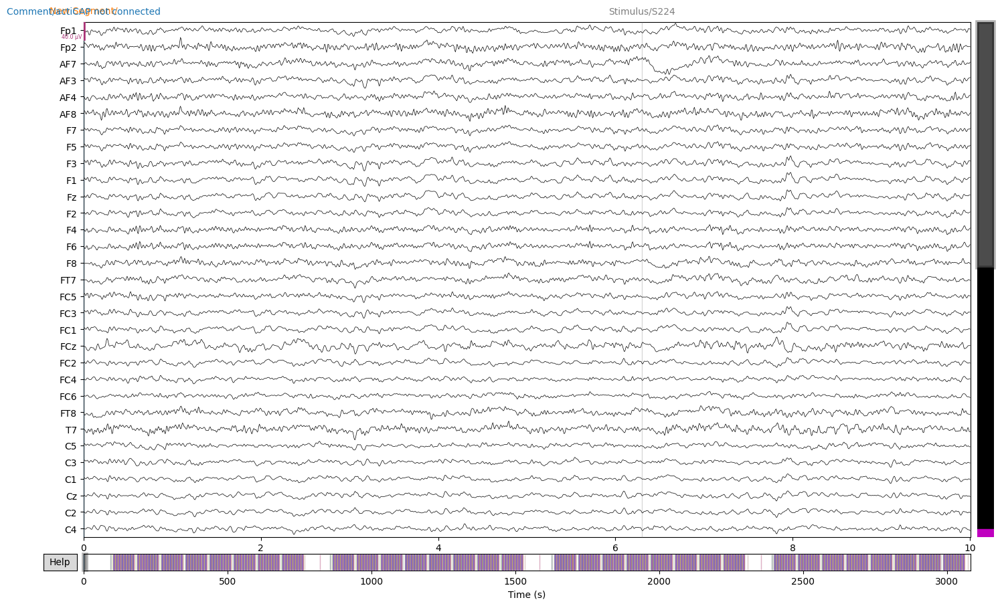

/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/442422814.py:89: RuntimeWarning: Encountered data in "short" format. Converting to float32.
  write_raw_bids(


In [8]:
# =============================================================================
# EEG preprocess
# =============================================================================
# Load the index of excluded subjects
excluded_sub_set = set() 
excluded_file = os.path.join(PATH_RAW_DATA_BIDS, 'sub_excluded.csv')

if os.path.exists(excluded_file):
    excluded_sub_df = pd.read_csv(excluded_file, header=None)
    excluded_sub_set = set(excluded_sub_df.iloc[:, 0].tolist())
    logger.info(f"Loaded {len(excluded_sub_set)} excluded subjects from file.")
else:
    logger.info("No excluded subjects file found; proceeding with empty exclusion list.")
bad_chs_full = []

for sub_idx in SUBJECT_IDS:
    if sub_idx in excluded_sub_set:
        continue

    logger.info(f"Processing subject: {sub_idx}")
    # === step 1: Load eeg and behavior data ===
    # Set path for loading 
    path_eeg = os.path.join(DS_ROOT_EEG, 
                            sub_idx, 
                            'eeg',
                            sub_idx+BIDS_TASK_LABEL_EEG+BIDS_EEG_SUFFIX + '.vhdr')
    assert os.path.exists(path_eeg), f"EEG file not found: {path_eeg}"

    # Load eeg and behavior data
    eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)

    # === Step 2: Main content of preprocessing ===
    # == 2.1 Set channel type to recgnize ==
    eeg_preprocess = eeg_bids.copy().set_channel_types({'VEOG': 'eog', 'HEOGL': 'eog', 'HEOGR': 'eog', 'ECG': 'ecg'})

    # == 2.2 Resample ==
    eeg_preprocess.resample(256, npad="auto")
    
    # == 2.3 Filtering ==
    eeg_preprocess.filter(1, 30, fir_design='firwin', picks=['eeg'])

    # == 2.4 re-reference ==
    eeg_preprocess.set_eeg_reference('average')  

    # == 2.5 Indentify bad channels by visual inspection==
    # Plot PSD to check first
    eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
    # Plot EEG data
    eeg_preprocess.plot(n_channels = 31,  block=True) #scalings = 20e-6,
    # Record bad channels
    bad_chans = eeg_preprocess.info['bads']
    if len(bad_chans) == 0:
        # No bad channels: add a raw, bad_channel is NaN
        bad_chs_full.append({
            "subj_idx": sub_idx,
            "bad_channel": pd.NA
        })
    else:
        # hava bad channels
        for bad_chan in bad_chans:
            bad_chs_full.append({
                "subj_idx": sub_idx,
                "bad_channel": bad_chan
            })

    # == 2.7 Remove artifacts using ICA ==
    # ica remove artifact
    eeg_chs = mne.pick_types(eeg_preprocess.info, eeg=True, exclude='bads') 
    n_eeg_good = len(eeg_chs)
    ica = mne.preprocessing.ICA(n_components=30, random_state=42, method='fastica')
    ica.fit(eeg_preprocess) 
    ica.exclude = []                                   
    eog_indices, eog_scores = ica.find_bads_eog(eeg_preprocess)
    ecg_indices, ecg_scores = ica.find_bads_ecg(eeg_preprocess)                                                                       
    ica.exclude = eog_indices + ecg_indices
    ica.apply(eeg_preprocess) 

    # == 2.8 Plot again to check ==
    eeg_preprocess.plot(n_channels = 31,  block=True)

    # === Step 3: Save preprocessed data into BIDS ===
    bids_path = BIDSPath(
        subject=sub_idx.replace('sub-STSWD', ''),
        task='MAAT',
        datatype='eeg',
        root=PATH_PREPROCESS_DATA_BIDS
    )

    write_raw_bids(
        raw=eeg_preprocess,
        bids_path=bids_path,
        format='BrainVision',
        allow_preload=True,
        overwrite=True,
        verbose=False
    )

# Save full bad channels cross subjects
bad_chs_full = pd.DataFrame(bad_chs_full)
bad_chs_full.to_csv(
        os.path.join(PATH_PREPROCESS_DATA_BIDS, 'all_bad_channels.csv'),
        index=False
    )

In [10]:
# =============================================================================
# Save cleaned behavior data into BIDS
# =============================================================================
# Load the index of excluded subjects
data_invalid_trials_full = pd.read_csv(os.path.join(PATH_RAW_DATA_BIDS, 'all_invalid_trials.csv'), header=0)

excluded_sub_df = pd.read_csv(os.path.join(PATH_RAW_DATA_BIDS, 'sub_excluded.csv'), header=None)
excluded_sub_set = set(excluded_sub_df.iloc[:, 0].tolist())

for sub_idx in SUBJECT_IDS:
    if sub_idx in excluded_sub_set:
        continue

    # Extract invalid trials.
    data_invalid_trial = data_invalid_trials_full[data_invalid_trials_full['subj_idx'] == sub_idx]
    invalid_from_behavior = set(data_invalid_trial['invalid_trial_index'])
    index_invalid_from_behavior = sorted(invalid_from_behavior)

    logger.info(f"Processing subject: {sub_idx}")

    # === Step 1: Load behavioral and eeg data ===
    # Set path for loading 
    path_beh = os.path.join(DS_ROOT_BEH, 
                            sub_idx+BIDS_TASK_LABEL_BEH+BIDS_BEH_SUFFIX + '.csv')
    assert os.path.exists(path_beh), f"Behavior file not found: {path_beh}"

    # Load behavior data
    data_behavior = pd.read_csv(path_beh, sep='\,' , header=0)

    # === Step 2: Select sepcific columns (aimed triggers) for behavior (eeg) data ===
    # Select specific columns: [-1, 11, 15, 14] → [subj_idx, condition, rt, response]
    data_behavior['subj_idx'] = sub_idx           # Add a column to get subject idx

    # === Step 3: Filter and save cleaned behavioral data ===
    data_behavior_clean= data_behavior.drop(index=index_invalid_from_behavior).reset_index(drop=True)

    # Save cleaned behavioral data into BIDS
    sub_idx = sub_idx.replace('STSWD', '')
    bids_path_beh = os.path.join(PATH_PREPROCESS_DATA_BIDS, sub_idx, 'beh')
    os.makedirs(bids_path_beh, exist_ok=True)
    beh_save_path = os.path.join(bids_path_beh, sub_idx+'_task-MAAT_beh.tsv')
    data_behavior_clean.to_csv(beh_save_path, sep='\t', index=False, na_rep='n/a')

    logger.info(f"Subject {sub_idx}: BIDS conversion completed.")  



2025-12-11 14:24:26,811 - INFO - Processing subject: sub-STSWD1118
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/2962955389.py:28: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 14:24:27,997 - INFO - Subject sub-1118: BIDS conversion completed.
2025-12-11 14:24:27,997 - INFO - Processing subject: sub-STSWD1120
/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_17620/2962955389.py:28: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data_behavior = pd.read_csv(path_beh, sep='\,' , header=0)
2025-12-11 14:24:28,00